In [3]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# Загрузка всех файлов
deposits_1_month = pd.read_excel('/Users/maximbortnik/Desktop/ALLL/ALL_deposits_1_month.xlsx')
deposits_3_month = pd.read_excel('/Users/maximbortnik/Desktop/ALLL/ALL_deposits_3_month.xlsx')
deposits_6_month = pd.read_excel('/Users/maximbortnik/Desktop/ALLL/ALL_deposits_6_month.xlsx')
deposits_1_year = pd.read_excel('/Users/maximbortnik/Desktop/ALLL/ALL_deposits_1_year.xlsx')
deposits_3_years = pd.read_excel('/Users/maximbortnik/Desktop/ALLL/ALL_deposits_3_years.xlsx')

loans_1_year = pd.read_excel('/Users/maximbortnik/Desktop/ALLL/ALL_loans_1_year.xlsx')
loans_3_years = pd.read_excel('/Users/maximbortnik/Desktop/ALLL/ALL_loans_3_years.xlsx')
loans_5_years = pd.read_excel('/Users/maximbortnik/Desktop/ALLL/ALL_loans_5_years.xlsx')
loans_10_years = pd.read_excel('/Users/maximbortnik/Desktop/ALLL/ALL_loans_10_years.xlsx')

# Функция для подготовки данных
def prepare_data(df, loan_type, term):
    df['loan_type'] = loan_type
    df['term'] = term
    df['Дата'] = pd.to_datetime(df['Дата'], errors='coerce')
    return df

# Приведение данных к единому виду
deposits_1_month = prepare_data(deposits_1_month, 'deposit', '1_month')
deposits_3_month = prepare_data(deposits_3_month, 'deposit', '3_months')
deposits_6_month = prepare_data(deposits_6_month, 'deposit', '6_months')
deposits_1_year = prepare_data(deposits_1_year, 'deposit', '1_year')
deposits_3_years = prepare_data(deposits_3_years, 'deposit', '3_years')

loans_1_year = prepare_data(loans_1_year, 'loan', '1_year')
loans_3_years = prepare_data(loans_3_years, 'loan', '3_years')
loans_5_years = prepare_data(loans_5_years, 'loan', '5_years')
loans_10_years = prepare_data(loans_10_years, 'loan', '10_years')

# Объединение всех данных в один DataFrame
all_data = pd.concat([deposits_1_month, deposits_3_month, deposits_6_month, deposits_1_year, deposits_3_years, 
                      loans_1_year, loans_3_years, loans_5_years, loans_10_years])


# Сортировка данных по дате
all_data.sort_values(by='Дата', inplace=True)
all_data.reset_index(drop=True, inplace=True)

/var/folders/bc/stp28mpd43n3qv1g5z13s7w00000gn/T/ipykernel_9943/3569133466.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_data_deposit_1_month['max_rate_change'] = 0.0
/var/folders/bc/stp28mpd43n3qv1g5z13s7w00000gn/T/ipykernel_9943/3569133466.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_data_deposit_1_month['min_rate_change'] = 0.0


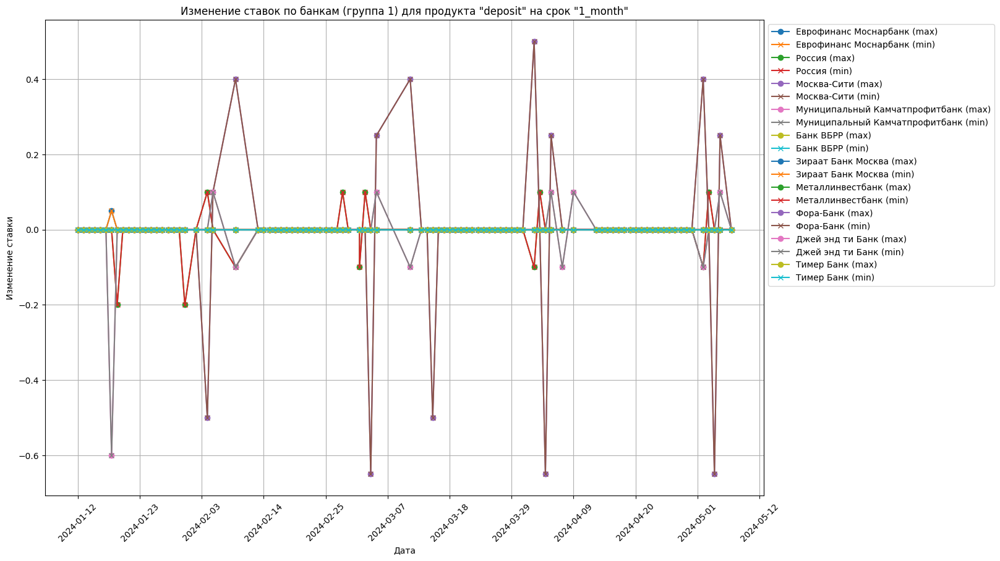

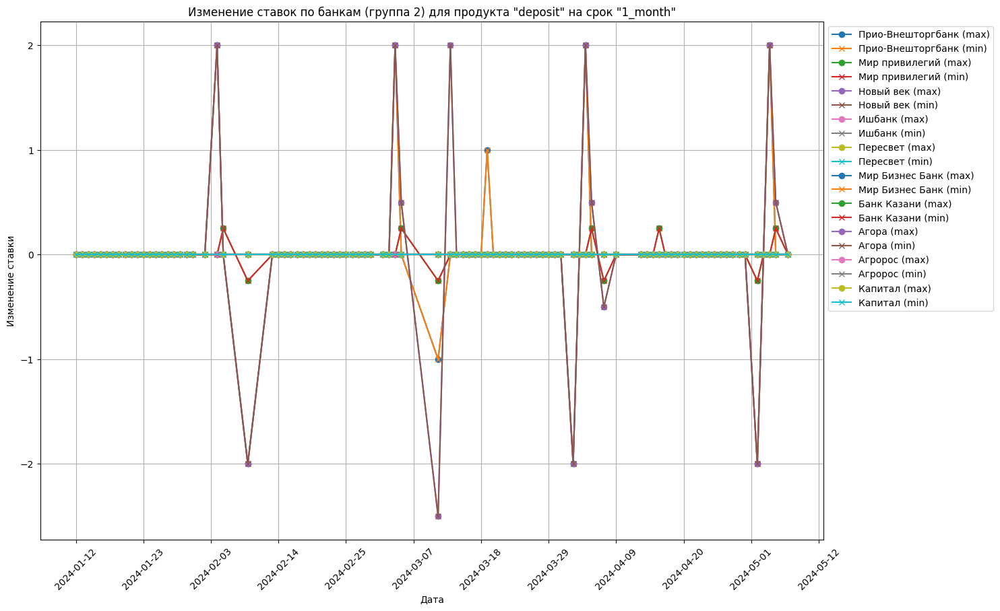

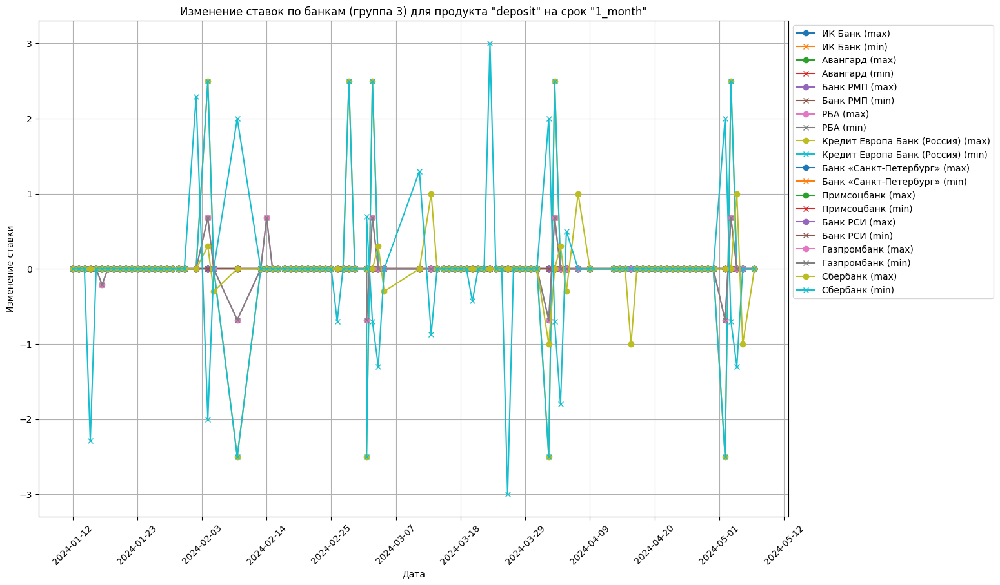

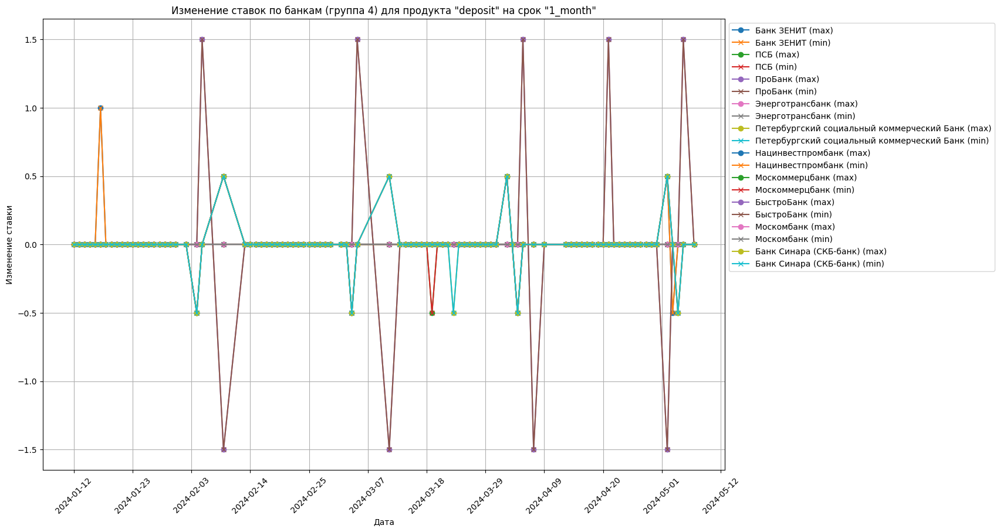

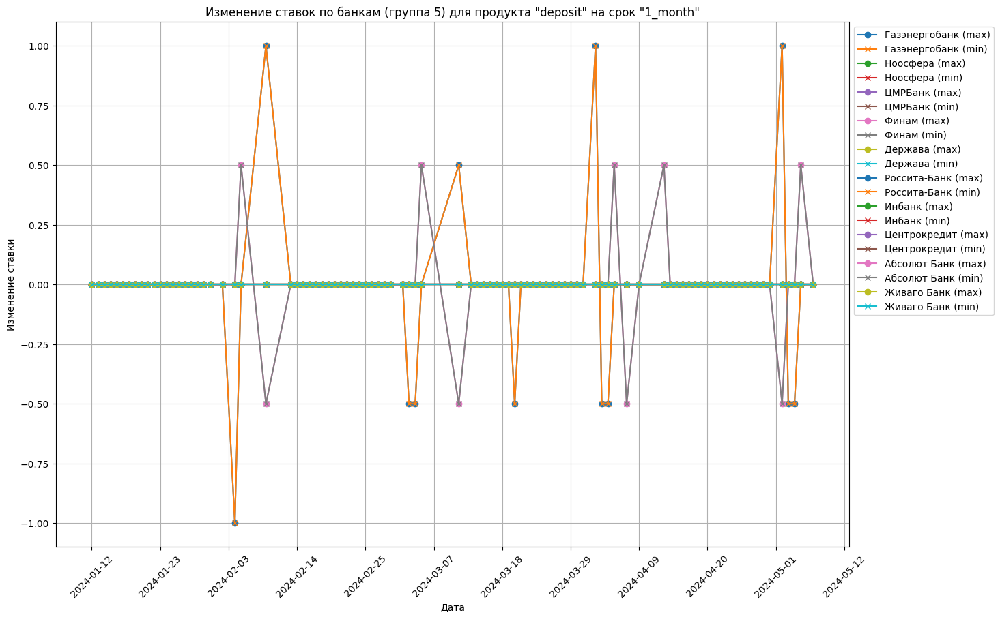

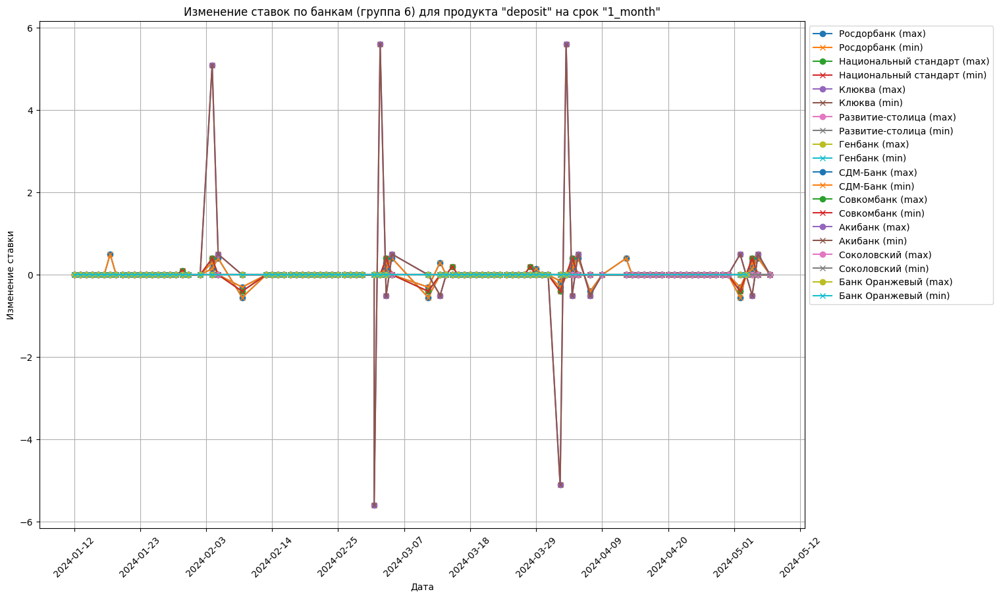

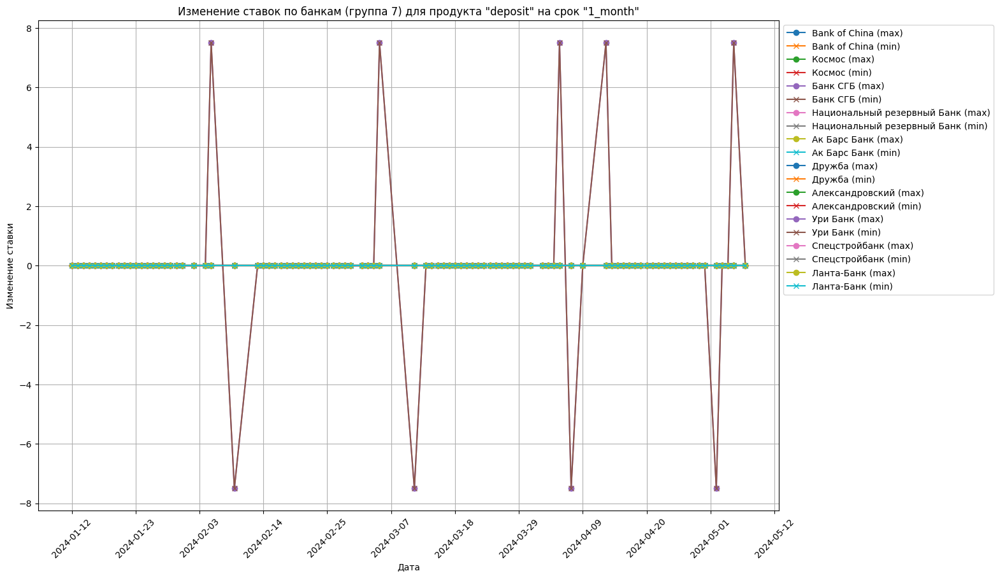

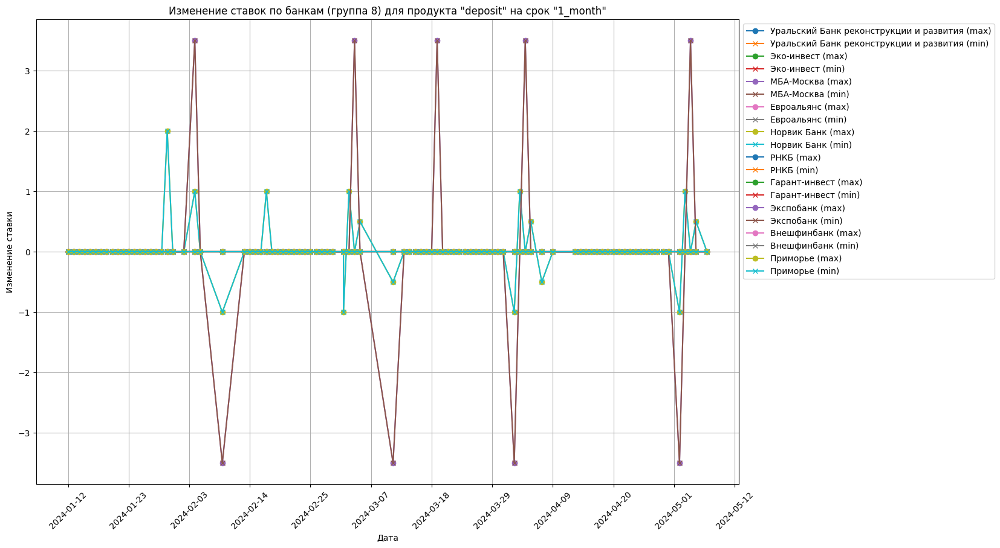

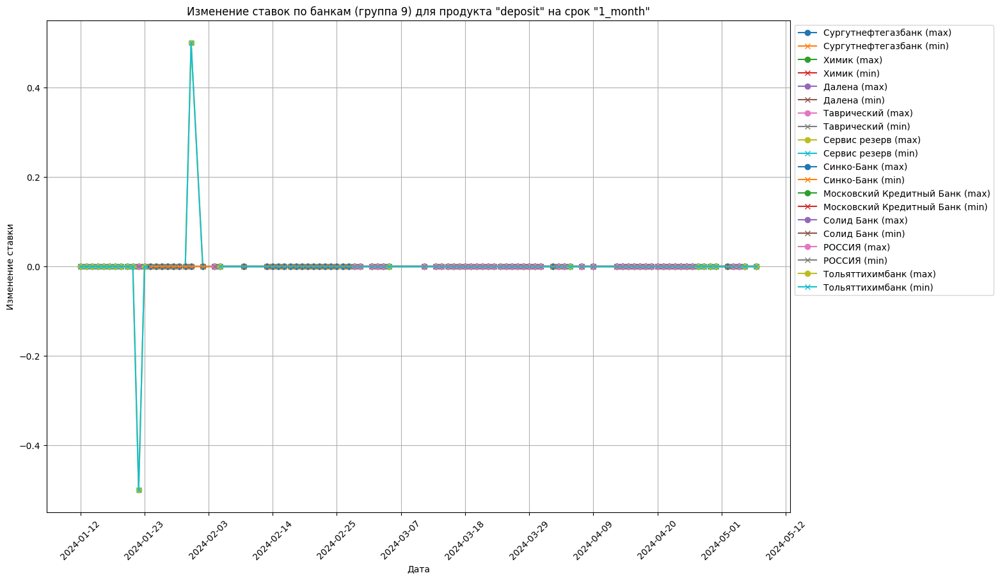

In [4]:
# Фильтрация данных по единому продукту: 'deposit' на срок '1_month'
filtered_data_deposit_1_month = all_data[(all_data['loan_type'] == 'deposit') & (all_data['term'] == '1_month')]

# Группировка данных по банкам
grouped = filtered_data_deposit_1_month.groupby('Название банка')

# Инициализация столбцов для изменений
filtered_data_deposit_1_month['max_rate_change'] = 0.0
filtered_data_deposit_1_month['min_rate_change'] = 0.0

# Рассчитываем изменения ставок для каждой записи
for bank, group in grouped:
    group = group.sort_values(by='Дата')
    previous_max_rate = group['Максимальная ставка'].iloc[0]
    previous_min_rate = group['Минимальная ставка'].iloc[0]
    
    filtered_data_deposit_1_month.loc[group.index[0], 'max_rate_change'] = 0
    filtered_data_deposit_1_month.loc[group.index[0], 'min_rate_change'] = 0
    
    for idx in group.index[1:]:
        max_rate_change = filtered_data_deposit_1_month.at[idx, 'Максимальная ставка'] - previous_max_rate
        min_rate_change = filtered_data_deposit_1_month.at[idx, 'Минимальная ставка'] - previous_min_rate
        
        filtered_data_deposit_1_month.at[idx, 'max_rate_change'] = max_rate_change
        filtered_data_deposit_1_month.at[idx, 'min_rate_change'] = min_rate_change
        
        previous_max_rate = filtered_data_deposit_1_month.at[idx, 'Максимальная ставка']
        previous_min_rate = filtered_data_deposit_1_month.at[idx, 'Минимальная ставка']

# Фильтрация данных по диапазону дат
start_date = '2024-01-12'
end_date = '2024-05-12'
filtered_data_deposit_1_month = filtered_data_deposit_1_month[(filtered_data_deposit_1_month['Дата'] >= start_date) & (filtered_data_deposit_1_month['Дата'] <= end_date)]

# Установка значений max_rate_change и min_rate_change равными 0 для первой записи каждого банка
first_occurrences = filtered_data_deposit_1_month.groupby('Название банка').head(1)
filtered_data_deposit_1_month.loc[first_occurrences.index, ['max_rate_change', 'min_rate_change']] = 0

# Сохранение итогового DataFrame в Excel
filtered_data_deposit_1_month.to_excel('/Users/maximbortnik/Desktop/ALL/deposit_1_month_filtered_data_withOUT_clusters.xlsx', index=False)

# Создаем полный диапазон дат
date_range = pd.date_range(start=start_date, end=end_date)
# Выбираем каждую 11-ю дату для отображения на оси X так как данные объемом 121 день
xticks = date_range[::11]

# Проверка наличия данных для каждого банка
if filtered_data_deposit_1_month.empty:
    print("Данные для анализа отсутствуют после фильтрации и удаления NaN значений.")
else:
    # Получение списка уникальных банков
    unique_banks = filtered_data_deposit_1_month['Название банка'].unique()
    
    # Разделение банков на 9 групп
    bank_groups = np.array_split(unique_banks, 9)
    
    # Построение графиков для каждой группы банков
    for i, bank_group in enumerate(bank_groups):
        plt.figure(figsize=(15, 10))
        
        for bank in bank_group:
            bank_data = filtered_data_deposit_1_month[filtered_data_deposit_1_month['Название банка'] == bank]
            plt.plot(bank_data['Дата'], bank_data['max_rate_change'], marker='o', label=f'{bank} (max)')
            plt.plot(bank_data['Дата'], bank_data['min_rate_change'], marker='x', label=f'{bank} (min)')
        
        plt.xlabel('Дата')
        plt.ylabel('Изменение ставки')
        plt.title(f'Изменение ставок по банкам (группа {i + 1}) для продукта "deposit" на срок "1_month"')
        plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
        plt.xticks(xticks, rotation=45)
        plt.grid(True)
        plt.show()

In [ ]:
# Фильтрация данных по единому продукту: 'deposit' на срок '1_year'
filtered_data_deposit_1_year = all_data[(all_data['loan_type'] == 'deposit') & (all_data['term'] == '1_year')]

# Группировка данных по банкам
grouped = filtered_data_deposit_1_year.groupby('Название банка')

# Инициализация столбцов для изменений
filtered_data_deposit_1_year['max_rate_change'] = 0.0
filtered_data_deposit_1_year['min_rate_change'] = 0.0

# Рассчитываем изменения ставок для каждой записи
for bank, group in grouped:
    group = group.sort_values(by='Дата')
    previous_max_rate = group['Максимальная ставка'].iloc[0]
    previous_min_rate = group['Минимальная ставка'].iloc[0]
    
    filtered_data_deposit_1_year.loc[group.index[0], 'max_rate_change'] = 0
    filtered_data_deposit_1_year.loc[group.index[0], 'min_rate_change'] = 0
    
    for idx in group.index[1:]:
        max_rate_change = filtered_data_deposit_1_year.at[idx, 'Максимальная ставка'] - previous_max_rate
        min_rate_change = filtered_data_deposit_1_year.at[idx, 'Минимальная ставка'] - previous_min_rate
        
        filtered_data_deposit_1_year.at[idx, 'max_rate_change'] = max_rate_change
        filtered_data_deposit_1_year.at[idx, 'min_rate_change'] = min_rate_change
        
        previous_max_rate = filtered_data_deposit_1_year.at[idx, 'Максимальная ставка']
        previous_min_rate = filtered_data_deposit_1_year.at[idx, 'Минимальная ставка']


# Фильтрация данных по диапазону дат
start_date = '2024-01-12'
end_date = '2024-05-12'
filtered_data_deposit_1_year = filtered_data_deposit_1_year[(filtered_data_deposit_1_year['Дата'] >= start_date) & (filtered_data_deposit_1_year['Дата'] <= end_date)]

# Установка значений max_rate_change и min_rate_change равными 0 для первой записи каждого банка
first_occurrences = filtered_data_deposit_1_year.groupby('Название банка').head(1)
filtered_data_deposit_1_year.loc[first_occurrences.index, ['max_rate_change', 'min_rate_change']] = 0

# Сохранение итогового DataFrame в Excel
filtered_data_deposit_1_year.to_excel('/Users/maximbortnik/Desktop/ALL/deposit_1_year_filtered_data_withOUT_clusters.xlsx', index=False)

# Создаем полный диапазон дат
date_range = pd.date_range(start=start_date, end=end_date)
# Выбираем каждую 11-ю дату для отображения на оси X так как данные объемом 121 день
xticks = date_range[::11]

# Проверка наличия данных для каждого банка
if filtered_data_deposit_1_year.empty:
    print("Данные для анализа отсутствуют после фильтрации и удаления NaN значений.")
else:
    # Получение списка уникальных банков
    unique_banks = filtered_data_deposit_1_year['Название банка'].unique()
    
    # Разделение банков на 9 групп
    bank_groups = np.array_split(unique_banks, 9)
    
    # Построение графиков для каждой группы банков
    for i, bank_group in enumerate(bank_groups):
        plt.figure(figsize=(15, 10))
        
        for bank in bank_group:
            bank_data = filtered_data_deposit_1_year[filtered_data_deposit_1_year['Название банка'] == bank]
            plt.plot(bank_data['Дата'], bank_data['max_rate_change'], marker='o', label=f'{bank} (max)')
            plt.plot(bank_data['Дата'], bank_data['min_rate_change'], marker='x', label=f'{bank} (min)')
        
        plt.xlabel('Дата')
        plt.ylabel('Изменение ставки')
        plt.title(f'Изменение ставок по банкам (группа {i + 1}) для продукта "deposit" на срок "1_year"')
        plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
        plt.xticks(xticks, rotation=45)
        plt.grid(True)
        plt.show()

/var/folders/bc/stp28mpd43n3qv1g5z13s7w00000gn/T/ipykernel_9943/2788954156.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_data_deposit_3_months['max_rate_change'] = 0.0
/var/folders/bc/stp28mpd43n3qv1g5z13s7w00000gn/T/ipykernel_9943/2788954156.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_data_deposit_3_months['min_rate_change'] = 0.0


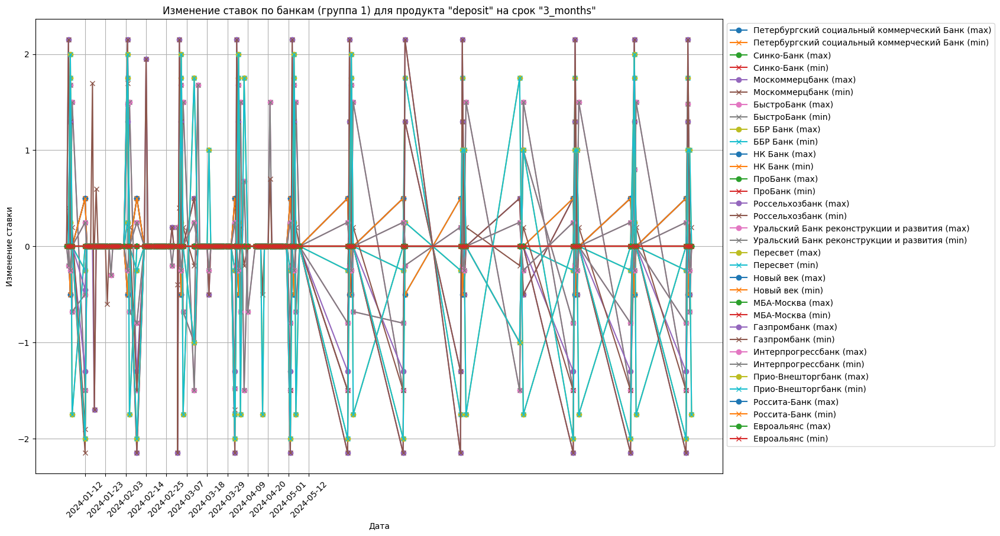

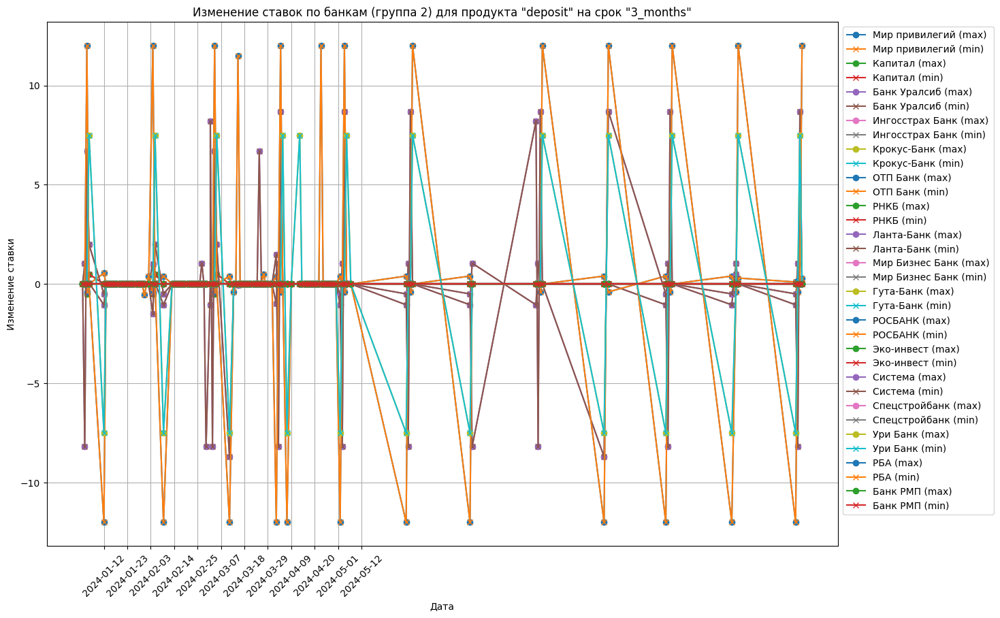

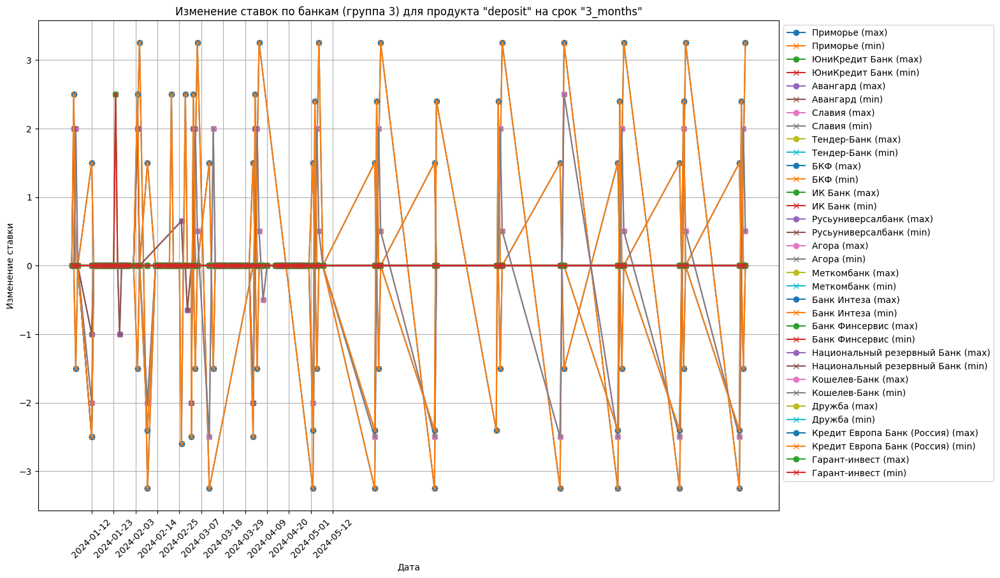

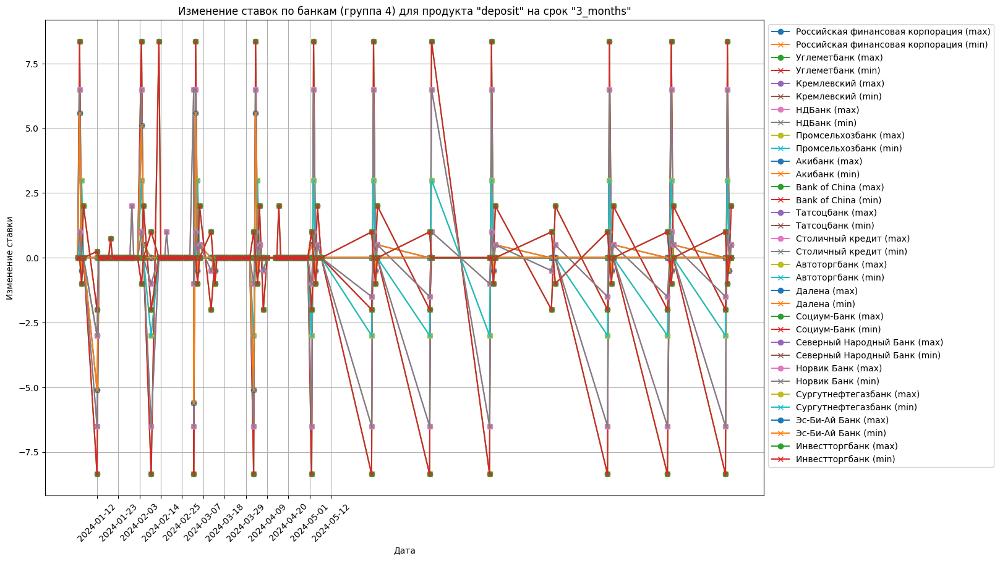

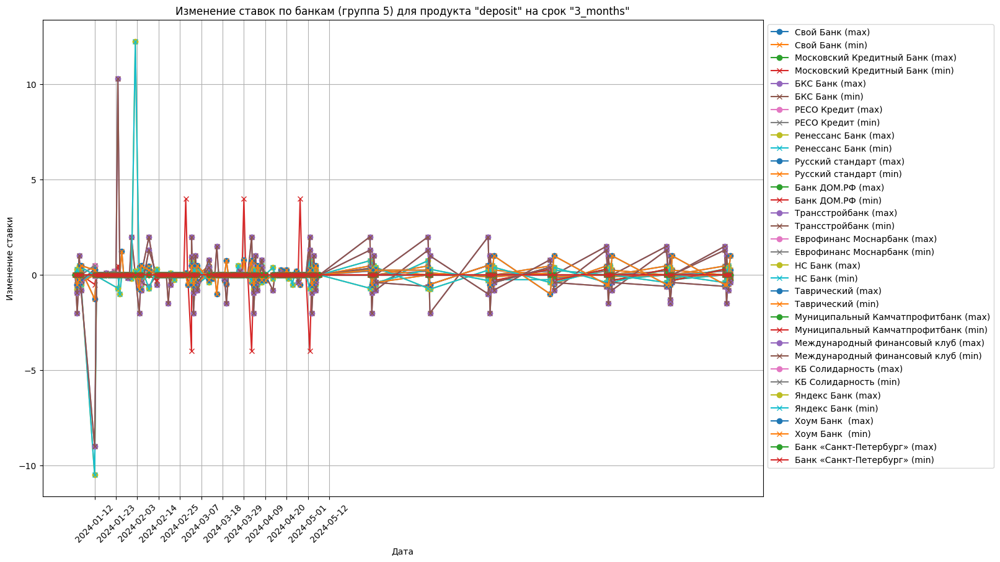

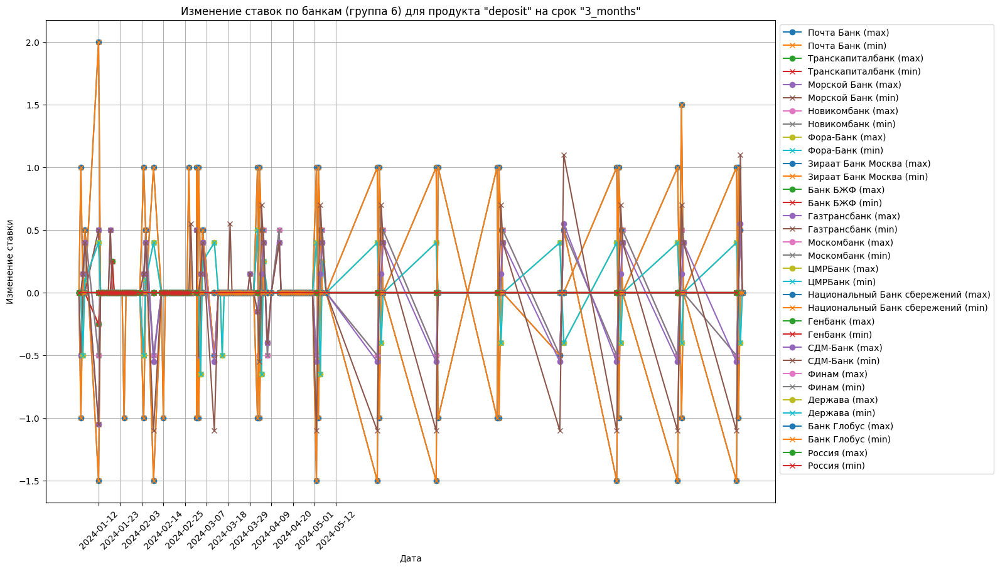

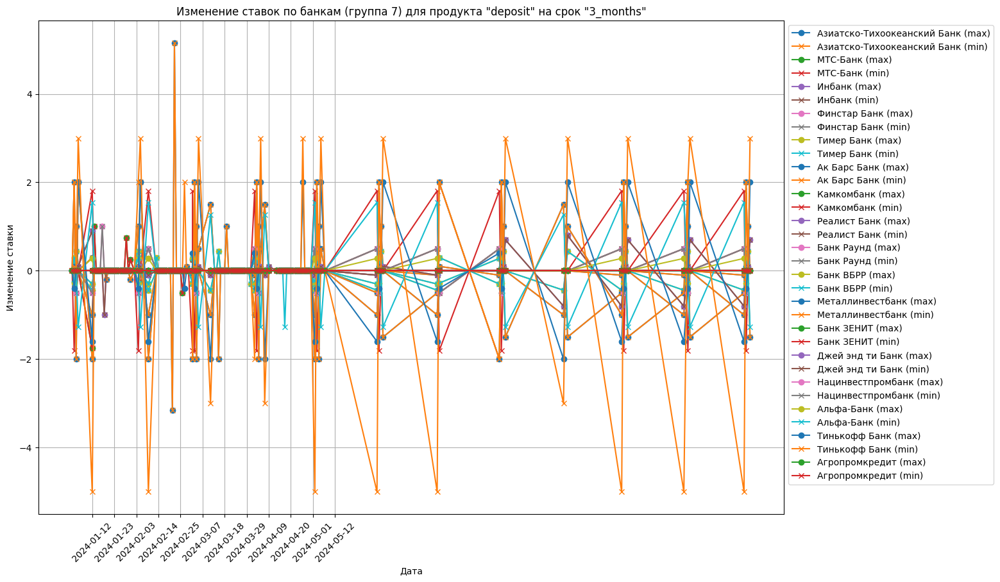

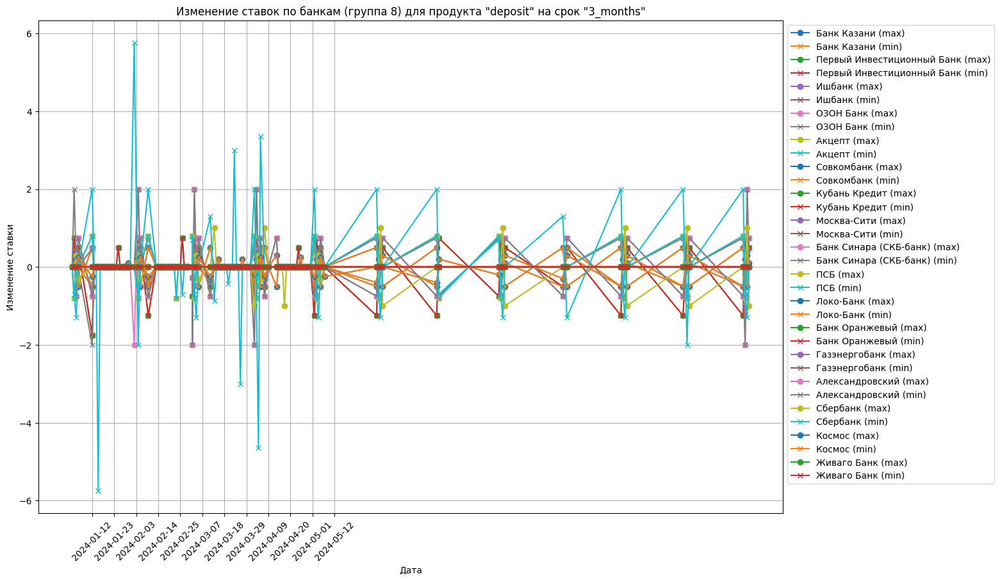

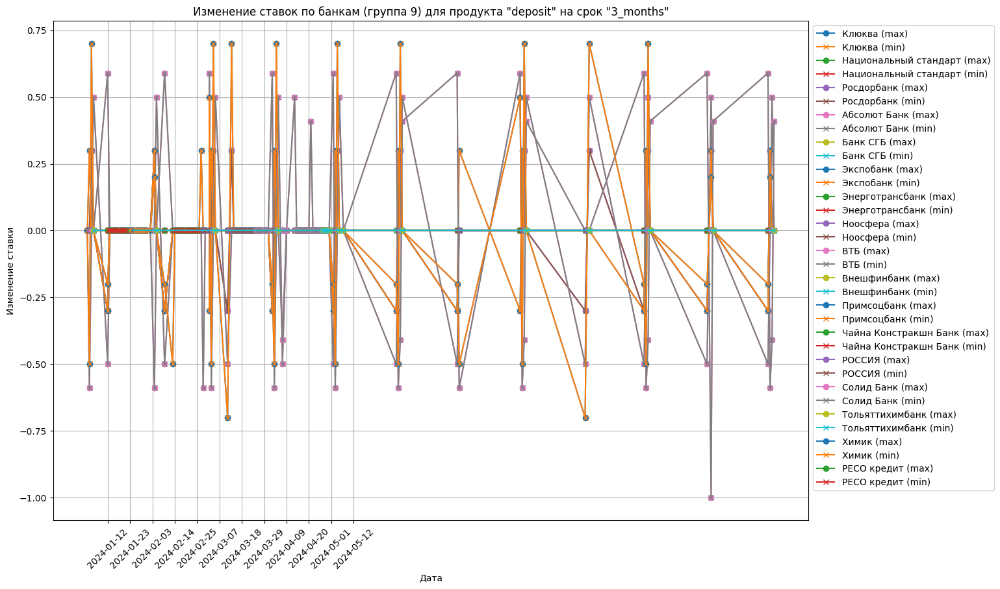

In [6]:
# Фильтрация данных по единому продукту: 'deposit' на срок '3_months'
filtered_data_deposit_3_months = all_data[(all_data['loan_type'] == 'deposit') & (all_data['term'] == '3_months')]

# Группировка данных по банкам
grouped = filtered_data_deposit_3_months.groupby('Название банка')

# Инициализация столбцов для изменений
filtered_data_deposit_3_months['max_rate_change'] = 0.0
filtered_data_deposit_3_months['min_rate_change'] = 0.0

# Рассчитываем изменения ставок для каждой записи
for bank, group in grouped:
    group = group.sort_values(by='Дата')
    previous_max_rate = group['Максимальная ставка'].iloc[0]
    previous_min_rate = group['Минимальная ставка'].iloc[0]
    
    filtered_data_deposit_3_months.loc[group.index[0], 'max_rate_change'] = 0
    filtered_data_deposit_3_months.loc[group.index[0], 'min_rate_change'] = 0
    
    for idx in group.index[1:]:
        max_rate_change = filtered_data_deposit_3_months.at[idx, 'Максимальная ставка'] - previous_max_rate
        min_rate_change = filtered_data_deposit_3_months.at[idx, 'Минимальная ставка'] - previous_min_rate
        
        filtered_data_deposit_3_months.at[idx, 'max_rate_change'] = max_rate_change
        filtered_data_deposit_3_months.at[idx, 'min_rate_change'] = min_rate_change
        
        previous_max_rate = filtered_data_deposit_3_months.at[idx, 'Максимальная ставка']
        previous_min_rate = filtered_data_deposit_3_months.at[idx, 'Минимальная ставка']


# Фильтрация данных по диапазону дат
start_date = '2024-01-12'
end_date = '2024-05-12'
filtered_data_deposit_3_month = filtered_data_deposit_3_months[(filtered_data_deposit_3_months['Дата'] >= start_date) & (filtered_data_deposit_3_months['Дата'] <= end_date)]

# Установка значений max_rate_change и min_rate_change равными 0 для первой записи каждого банка
first_occurrences = filtered_data_deposit_3_months.groupby('Название банка').head(1)
filtered_data_deposit_3_months.loc[first_occurrences.index, ['max_rate_change', 'min_rate_change']] = 0

# Сохранение итогового DataFrame в Excel
filtered_data_deposit_3_months.to_excel('/Users/maximbortnik/Desktop/ALL/deposit_3_months_filtered_data_withOUT_clusters.xlsx', index=False)

# Создаем полный диапазон дат
date_range = pd.date_range(start=start_date, end=end_date)
# Выбираем каждую 11-ю дату для отображения на оси X так как данные объемом 121 день
xticks = date_range[::11]

# Проверка наличия данных для каждого банка
if filtered_data_deposit_3_months.empty:
    print("Данные для анализа отсутствуют после фильтрации и удаления NaN значений.")
else:
    # Получение списка уникальных банков
    unique_banks = filtered_data_deposit_3_months['Название банка'].unique()
    
    # Разделение банков на 9 групп
    bank_groups = np.array_split(unique_banks, 9)
    
    # Построение графиков для каждой группы банков
    for i, bank_group in enumerate(bank_groups):
        plt.figure(figsize=(15, 10))
        
        for bank in bank_group:
            bank_data = filtered_data_deposit_3_months[filtered_data_deposit_3_months['Название банка'] == bank]
            plt.plot(bank_data['Дата'], bank_data['max_rate_change'], marker='o', label=f'{bank} (max)')
            plt.plot(bank_data['Дата'], bank_data['min_rate_change'], marker='x', label=f'{bank} (min)')
        
        plt.xlabel('Дата')
        plt.ylabel('Изменение ставки')
        plt.title(f'Изменение ставок по банкам (группа {i + 1}) для продукта "deposit" на срок "3_months"')
        plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
        plt.xticks(xticks, rotation=45)
        plt.grid(True)
        plt.show()

/var/folders/bc/stp28mpd43n3qv1g5z13s7w00000gn/T/ipykernel_9943/2439924796.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_data_deposit_6_months['max_rate_change'] = 0.0
/var/folders/bc/stp28mpd43n3qv1g5z13s7w00000gn/T/ipykernel_9943/2439924796.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_data_deposit_6_months['min_rate_change'] = 0.0


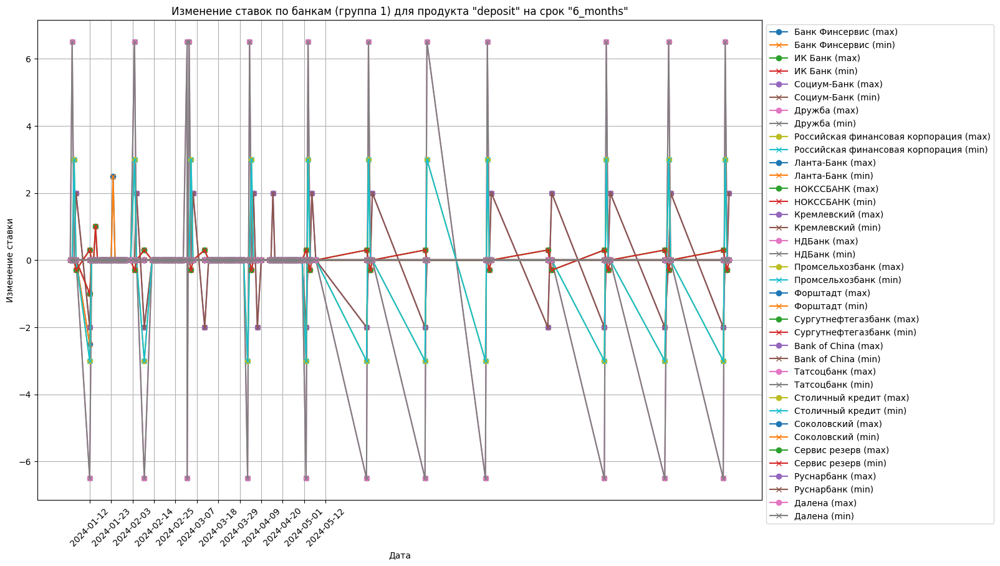

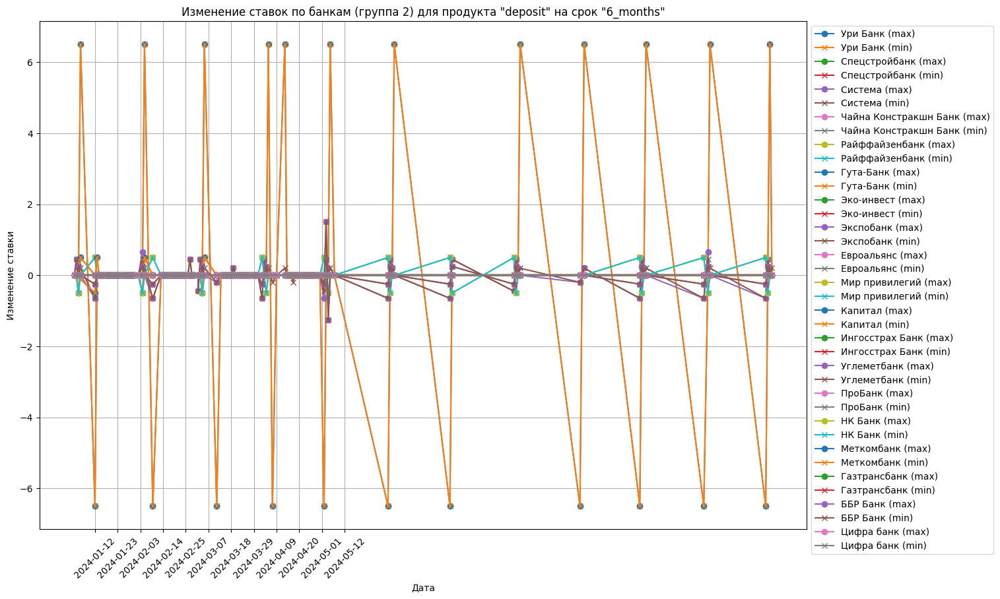

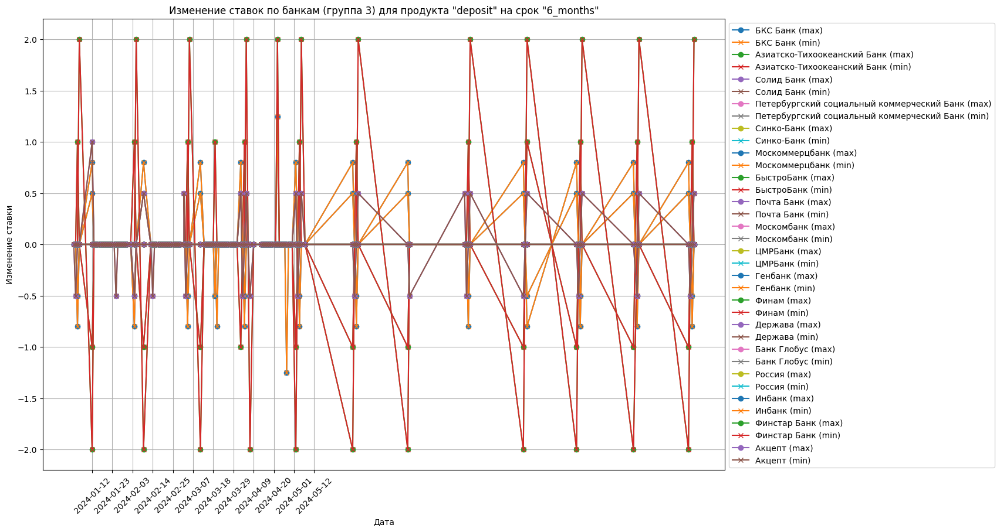

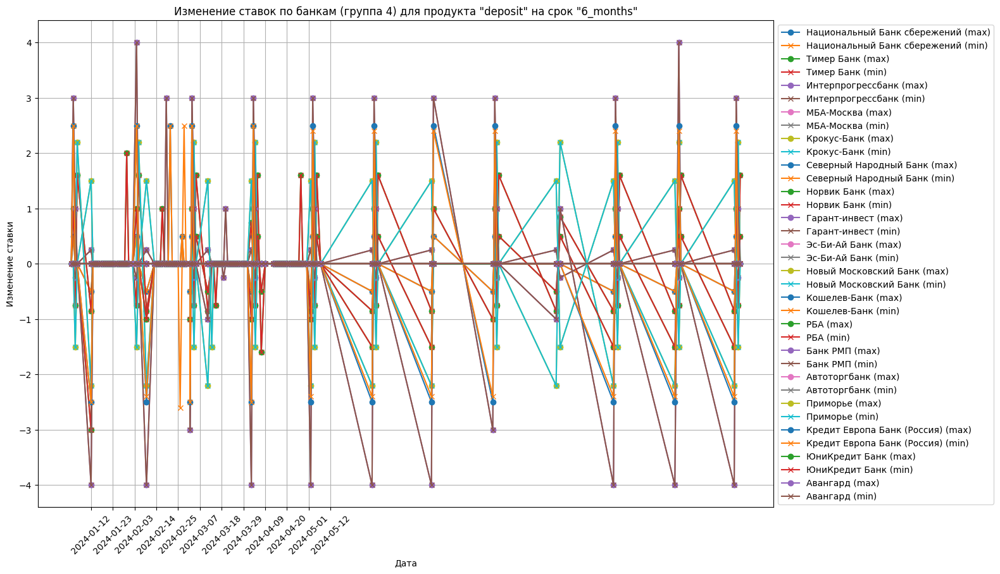

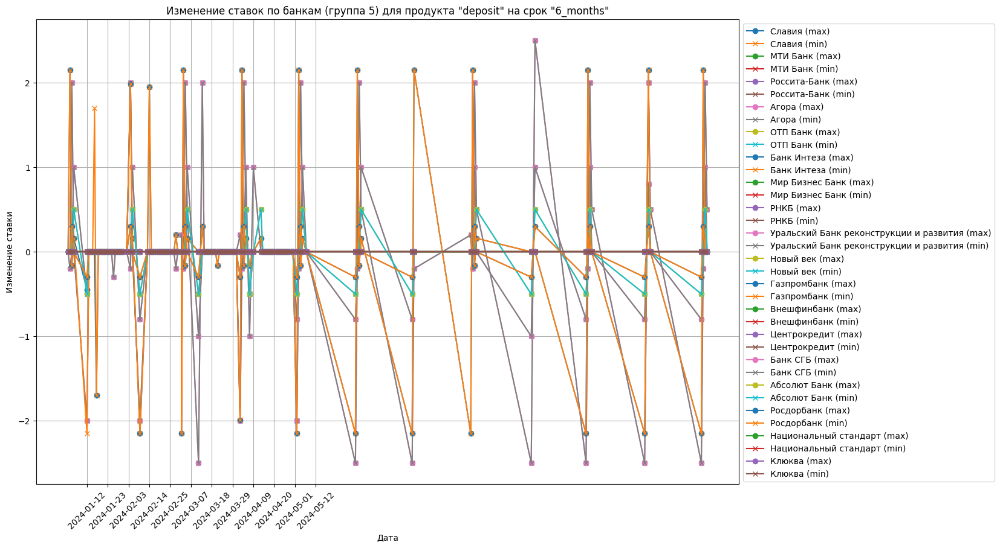

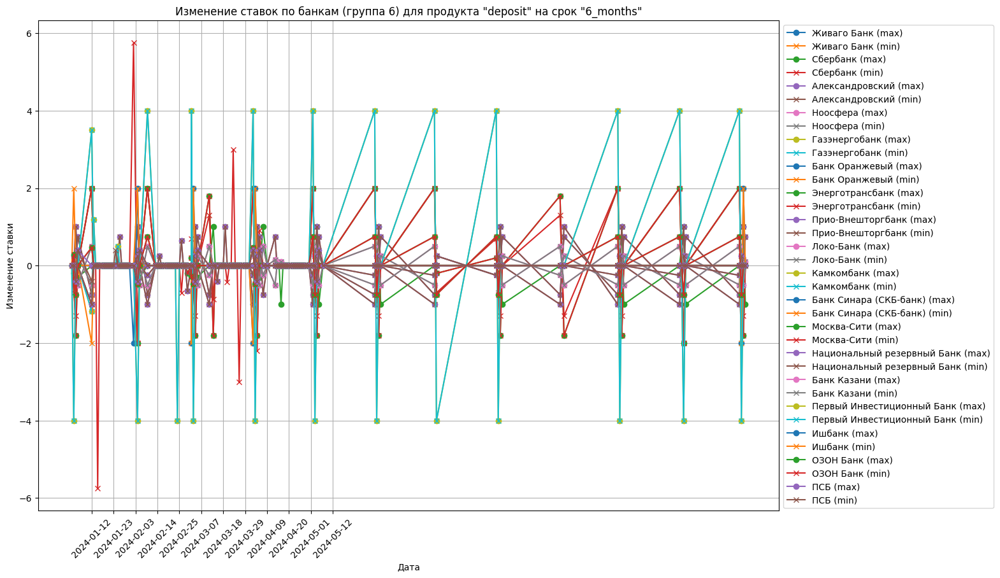

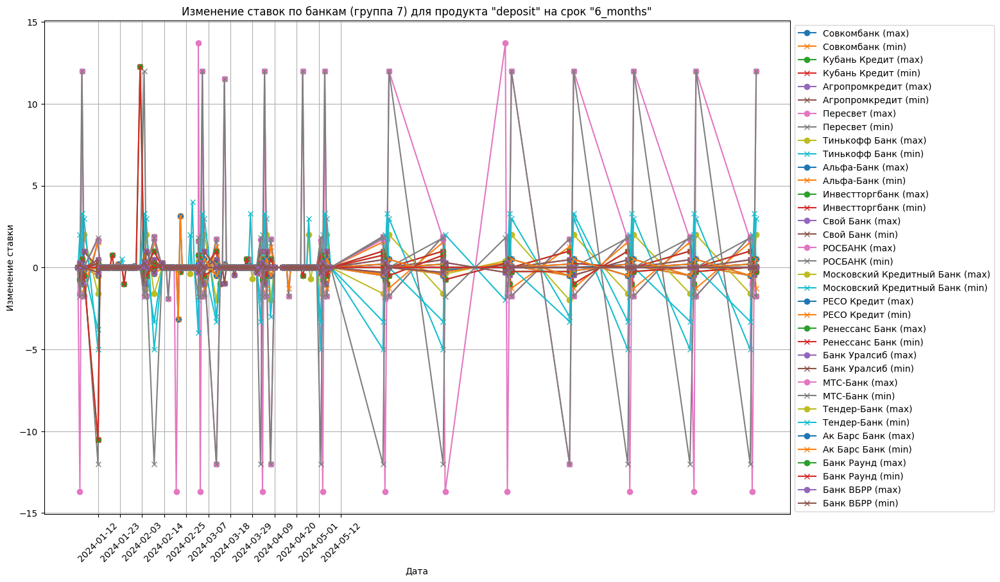

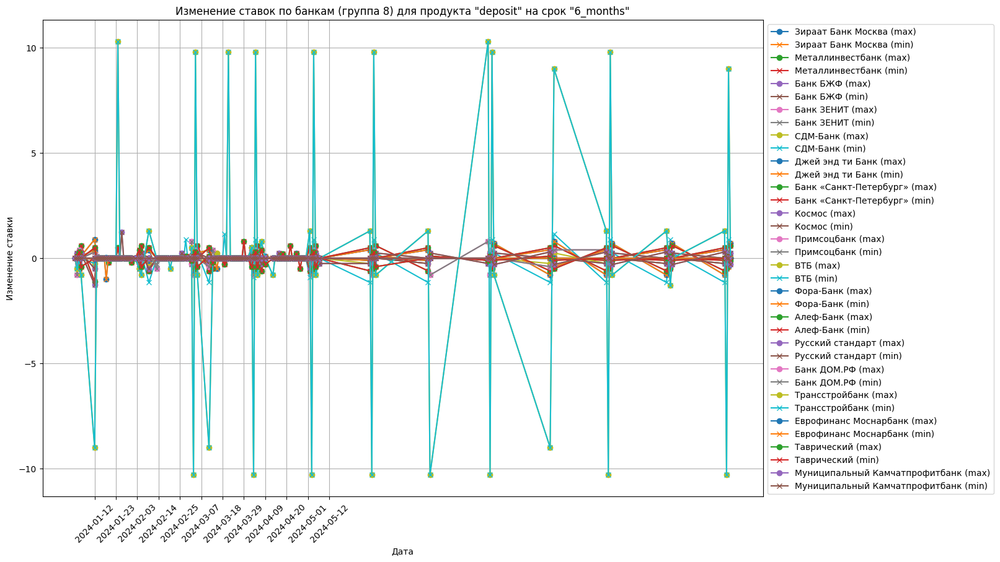

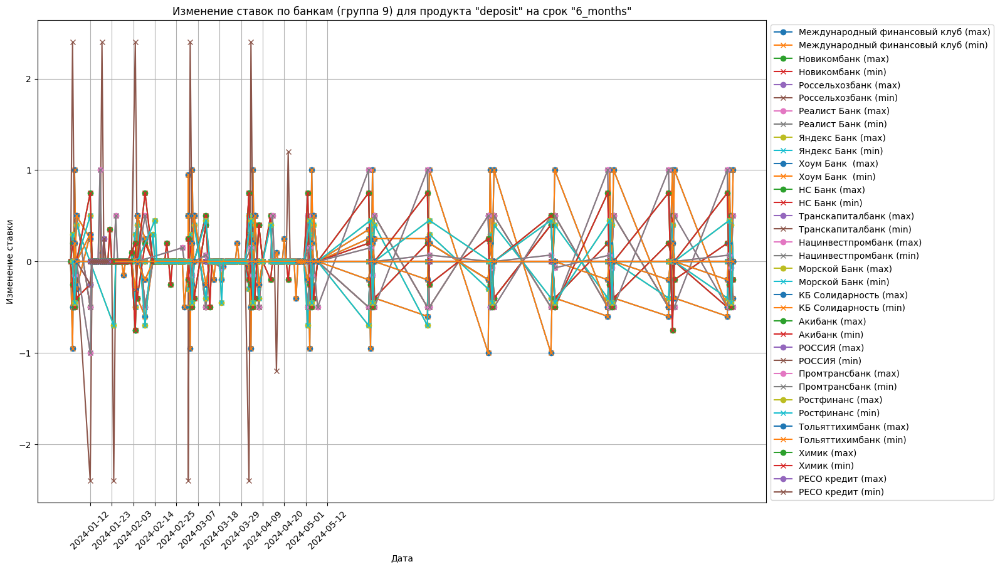

In [7]:
# Фильтрация данных по единому продукту: 'deposit' на срок '6_months'
filtered_data_deposit_6_months = all_data[(all_data['loan_type'] == 'deposit') & (all_data['term'] == '6_months')]

# Группировка данных по банкам
grouped = filtered_data_deposit_6_months.groupby('Название банка')

# Инициализация столбцов для изменений
filtered_data_deposit_6_months['max_rate_change'] = 0.0
filtered_data_deposit_6_months['min_rate_change'] = 0.0

# Рассчитываем изменения ставок для каждой записи
for bank, group in grouped:
    group = group.sort_values(by='Дата')
    previous_max_rate = group['Максимальная ставка'].iloc[0]
    previous_min_rate = group['Минимальная ставка'].iloc[0]
    
    filtered_data_deposit_6_months.loc[group.index[0], 'max_rate_change'] = 0
    filtered_data_deposit_6_months.loc[group.index[0], 'min_rate_change'] = 0
    
    for idx in group.index[1:]:
        max_rate_change = filtered_data_deposit_6_months.at[idx, 'Максимальная ставка'] - previous_max_rate
        min_rate_change = filtered_data_deposit_6_months.at[idx, 'Минимальная ставка'] - previous_min_rate
        
        filtered_data_deposit_6_months.at[idx, 'max_rate_change'] = max_rate_change
        filtered_data_deposit_6_months.at[idx, 'min_rate_change'] = min_rate_change
        
        previous_max_rate = filtered_data_deposit_6_months.at[idx, 'Максимальная ставка']
        previous_min_rate = filtered_data_deposit_6_months.at[idx, 'Минимальная ставка']


# Фильтрация данных по диапазону дат
start_date = '2024-01-12'
end_date = '2024-05-12'
filtered_data_deposit_3_month = filtered_data_deposit_6_months[(filtered_data_deposit_6_months['Дата'] >= start_date) & (filtered_data_deposit_6_months['Дата'] <= end_date)]

# Установка значений max_rate_change и min_rate_change равными 0 для первой записи каждого банка
first_occurrences = filtered_data_deposit_6_months.groupby('Название банка').head(1)
filtered_data_deposit_6_months.loc[first_occurrences.index, ['max_rate_change', 'min_rate_change']] = 0

# Сохранение итогового DataFrame в Excel
filtered_data_deposit_6_months.to_excel('/Users/maximbortnik/Desktop/ALL/deposit_6_months_filtered_data_withOUT_clusters.xlsx', index=False)

# Создаем полный диапазон дат
date_range = pd.date_range(start=start_date, end=end_date)
# Выбираем каждую 11-ю дату для отображения на оси X так как данные объемом 121 день
xticks = date_range[::11]

# Проверка наличия данных для каждого банка
if filtered_data_deposit_6_months.empty:
    print("Данные для анализа отсутствуют после фильтрации и удаления NaN значений.")
else:
    # Получение списка уникальных банков
    unique_banks = filtered_data_deposit_6_months['Название банка'].unique()
    
    # Разделение банков на 9 групп
    bank_groups = np.array_split(unique_banks, 9)
    
    # Построение графиков для каждой группы банков
    for i, bank_group in enumerate(bank_groups):
        plt.figure(figsize=(15, 10))
        
        for bank in bank_group:
            bank_data = filtered_data_deposit_6_months[filtered_data_deposit_6_months['Название банка'] == bank]
            plt.plot(bank_data['Дата'], bank_data['max_rate_change'], marker='o', label=f'{bank} (max)')
            plt.plot(bank_data['Дата'], bank_data['min_rate_change'], marker='x', label=f'{bank} (min)')
        
        plt.xlabel('Дата')
        plt.ylabel('Изменение ставки')
        plt.title(f'Изменение ставок по банкам (группа {i + 1}) для продукта "deposit" на срок "6_months"')
        plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
        plt.xticks(xticks, rotation=45)
        plt.grid(True)
        plt.show()

/var/folders/bc/stp28mpd43n3qv1g5z13s7w00000gn/T/ipykernel_9943/1501435118.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_data_deposit_3_years['max_rate_change'] = 0.0
/var/folders/bc/stp28mpd43n3qv1g5z13s7w00000gn/T/ipykernel_9943/1501435118.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_data_deposit_3_years['min_rate_change'] = 0.0


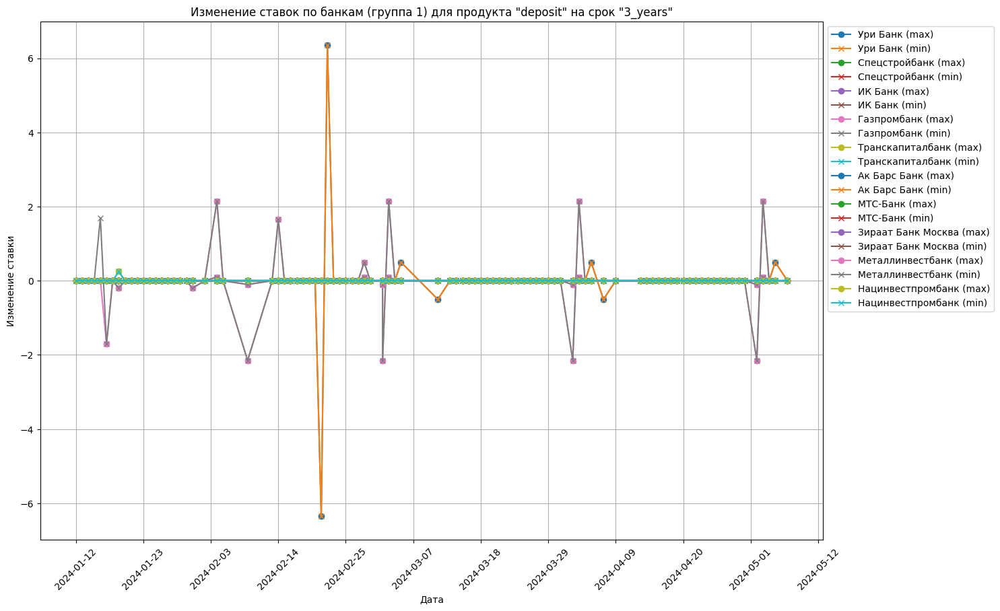

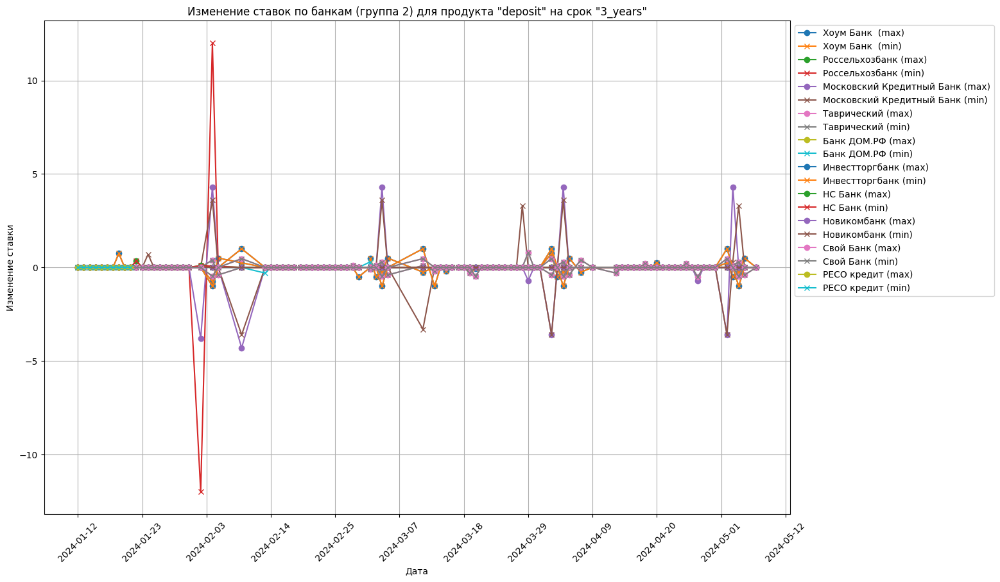

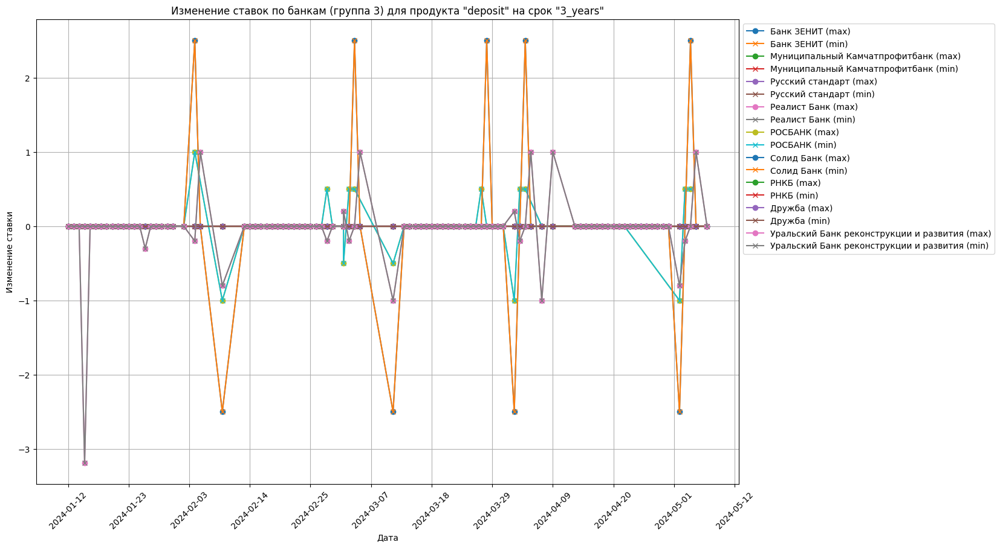

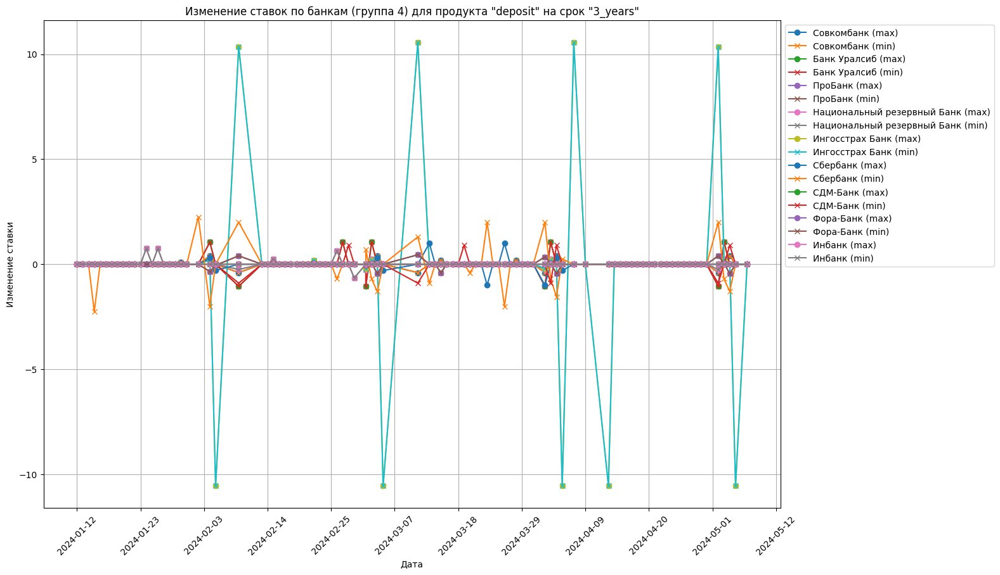

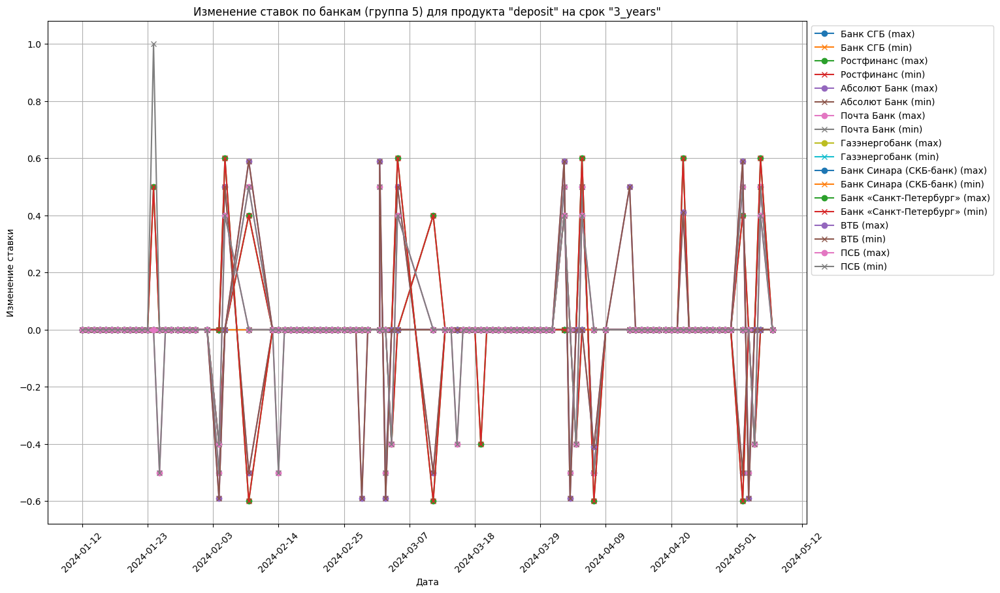

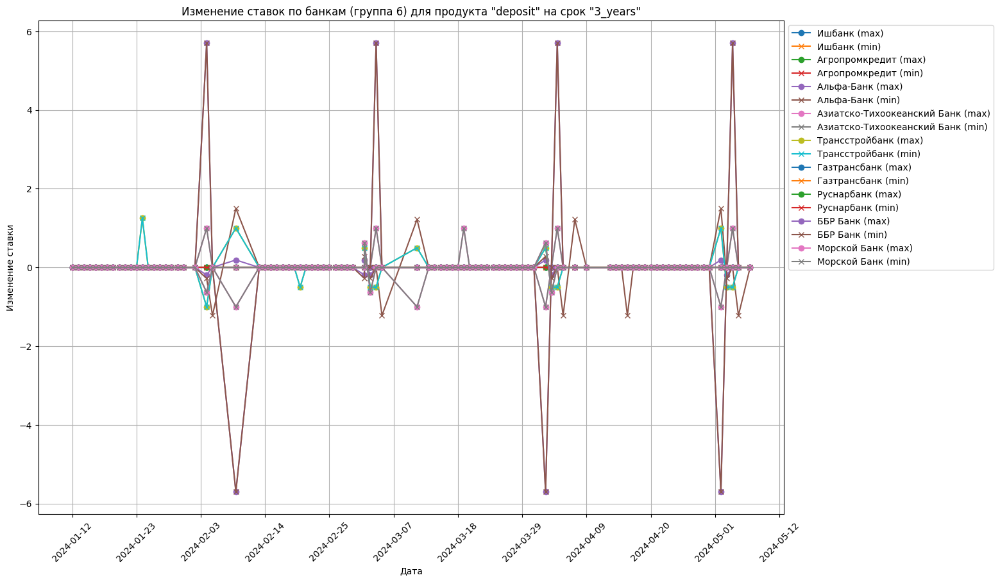

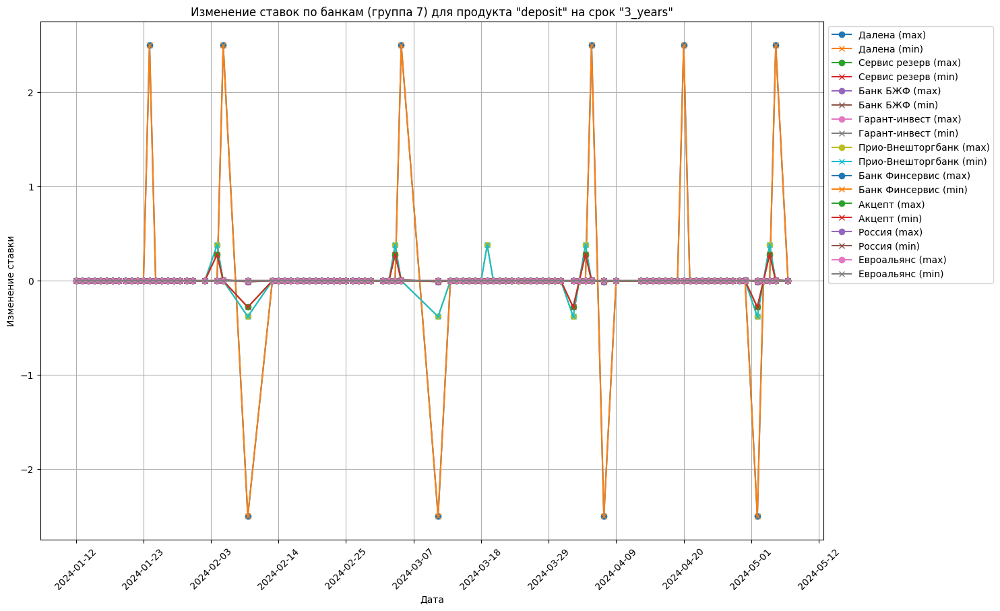

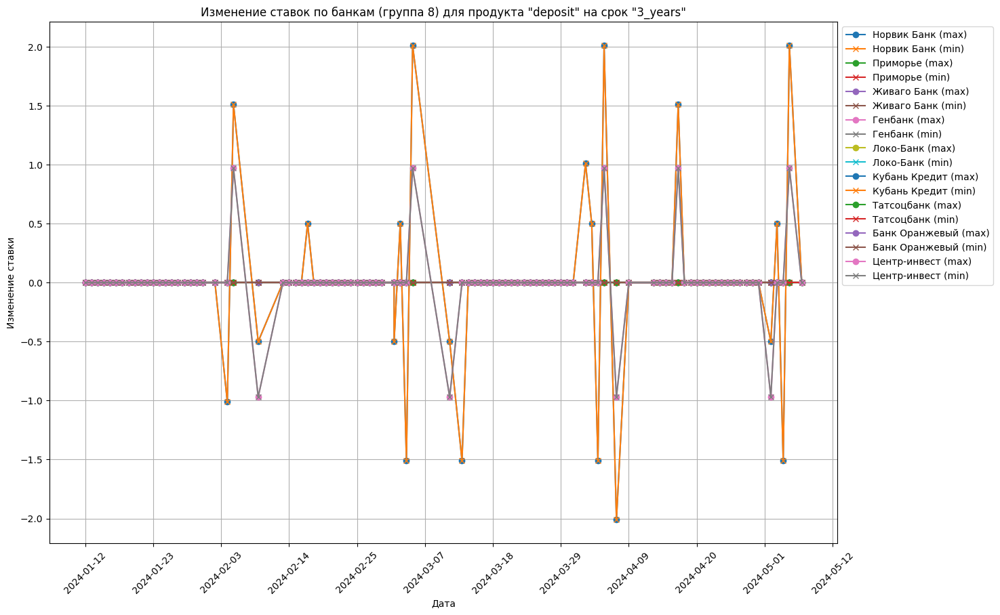

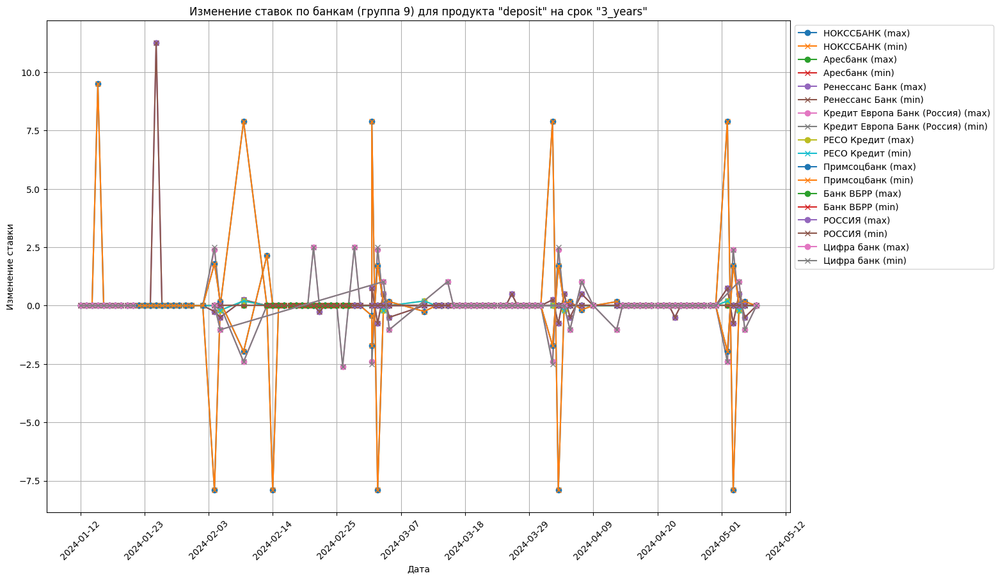

In [8]:
# Фильтрация данных по единому продукту: 'deposit' на срок '3_years'
filtered_data_deposit_3_years = all_data[(all_data['loan_type'] == 'deposit') & (all_data['term'] == '3_years')]

# Группировка данных по банкам
grouped = filtered_data_deposit_3_years.groupby('Название банка')

# Инициализация столбцов для изменений
filtered_data_deposit_3_years['max_rate_change'] = 0.0
filtered_data_deposit_3_years['min_rate_change'] = 0.0

# Рассчитываем изменения ставок для каждой записи
for bank, group in grouped:
    group = group.sort_values(by='Дата')
    previous_max_rate = group['Максимальная ставка'].iloc[0]
    previous_min_rate = group['Минимальная ставка'].iloc[0]
    
    filtered_data_deposit_3_years.loc[group.index[0], 'max_rate_change'] = 0
    filtered_data_deposit_3_years.loc[group.index[0], 'min_rate_change'] = 0
    
    for idx in group.index[1:]:
        max_rate_change = filtered_data_deposit_3_years.at[idx, 'Максимальная ставка'] - previous_max_rate
        min_rate_change = filtered_data_deposit_3_years.at[idx, 'Минимальная ставка'] - previous_min_rate
        
        filtered_data_deposit_3_years.at[idx, 'max_rate_change'] = max_rate_change
        filtered_data_deposit_3_years.at[idx, 'min_rate_change'] = min_rate_change
        
        previous_max_rate = filtered_data_deposit_3_years.at[idx, 'Максимальная ставка']
        previous_min_rate = filtered_data_deposit_3_years.at[idx, 'Минимальная ставка']


# Фильтрация данных по диапазону дат
start_date = '2024-01-12'
end_date = '2024-05-12'
filtered_data_deposit_3_years = filtered_data_deposit_3_years[(filtered_data_deposit_3_years['Дата'] >= start_date) & (filtered_data_deposit_3_years['Дата'] <= end_date)]

# Установка значений max_rate_change и min_rate_change равными 0 для первой записи каждого банка
first_occurrences = filtered_data_deposit_3_years.groupby('Название банка').head(1)
filtered_data_deposit_3_years.loc[first_occurrences.index, ['max_rate_change', 'min_rate_change']] = 0

# Сохранение итогового DataFrame в Excel
filtered_data_deposit_3_years.to_excel('/Users/maximbortnik/Desktop/ALL/deposit_3_years_filtered_data_withOUT_clusters.xlsx', index=False)

# Создаем полный диапазон дат
date_range = pd.date_range(start=start_date, end=end_date)
# Выбираем каждую 11-ю дату для отображения на оси X так как данные объемом 121 день
xticks = date_range[::11]

# Проверка наличия данных для каждого банка
if filtered_data_deposit_3_years.empty:
    print("Данные для анализа отсутствуют после фильтрации и удаления NaN значений.")
else:
    # Получение списка уникальных банков
    unique_banks = filtered_data_deposit_3_years['Название банка'].unique()
    
    # Разделение банков на 9 групп
    bank_groups = np.array_split(unique_banks, 9)
    
    # Построение графиков для каждой группы банков
    for i, bank_group in enumerate(bank_groups):
        plt.figure(figsize=(15, 10))
        
        for bank in bank_group:
            bank_data = filtered_data_deposit_3_years[filtered_data_deposit_3_years['Название банка'] == bank]
            plt.plot(bank_data['Дата'], bank_data['max_rate_change'], marker='o', label=f'{bank} (max)')
            plt.plot(bank_data['Дата'], bank_data['min_rate_change'], marker='x', label=f'{bank} (min)')
        
        plt.xlabel('Дата')
        plt.ylabel('Изменение ставки')
        plt.title(f'Изменение ставок по банкам (группа {i + 1}) для продукта "deposit" на срок "3_years"')
        plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
        plt.xticks(xticks, rotation=45)
        plt.grid(True)
        plt.show()

/var/folders/bc/stp28mpd43n3qv1g5z13s7w00000gn/T/ipykernel_9943/265697463.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_data_loan_1_year['max_rate_change'] = 0.0
/var/folders/bc/stp28mpd43n3qv1g5z13s7w00000gn/T/ipykernel_9943/265697463.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_data_loan_1_year['min_rate_change'] = 0.0


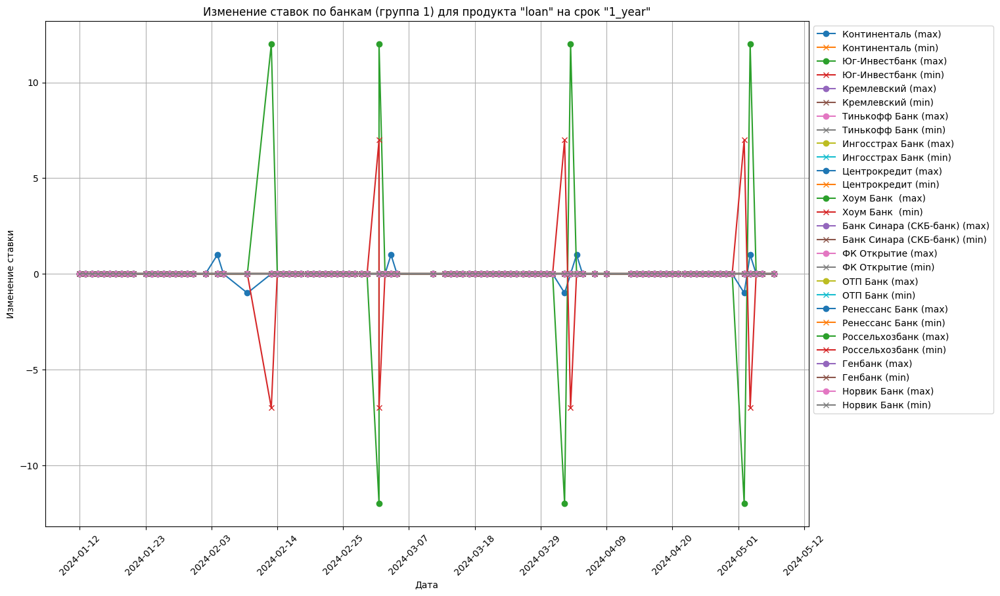

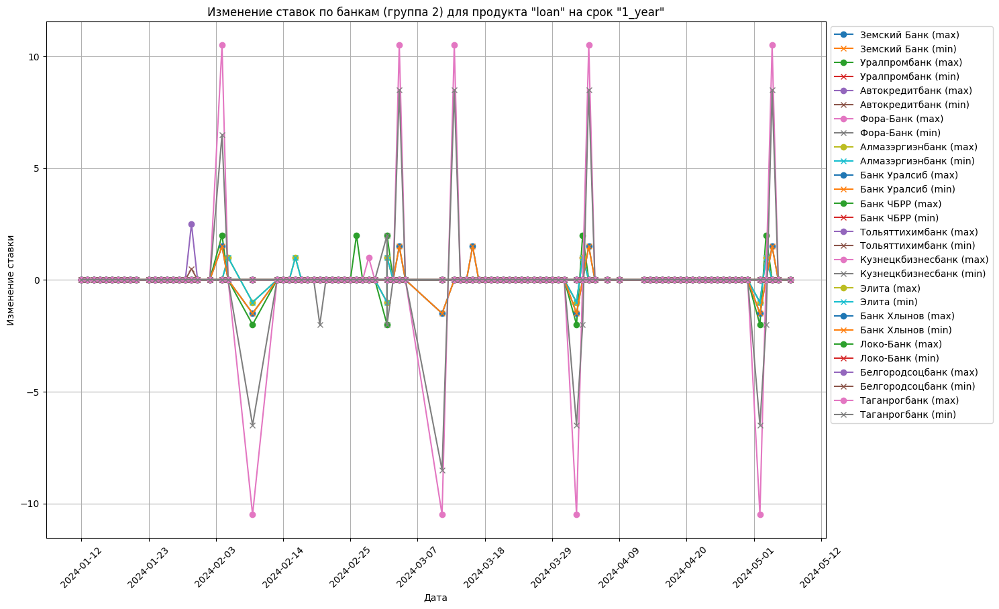

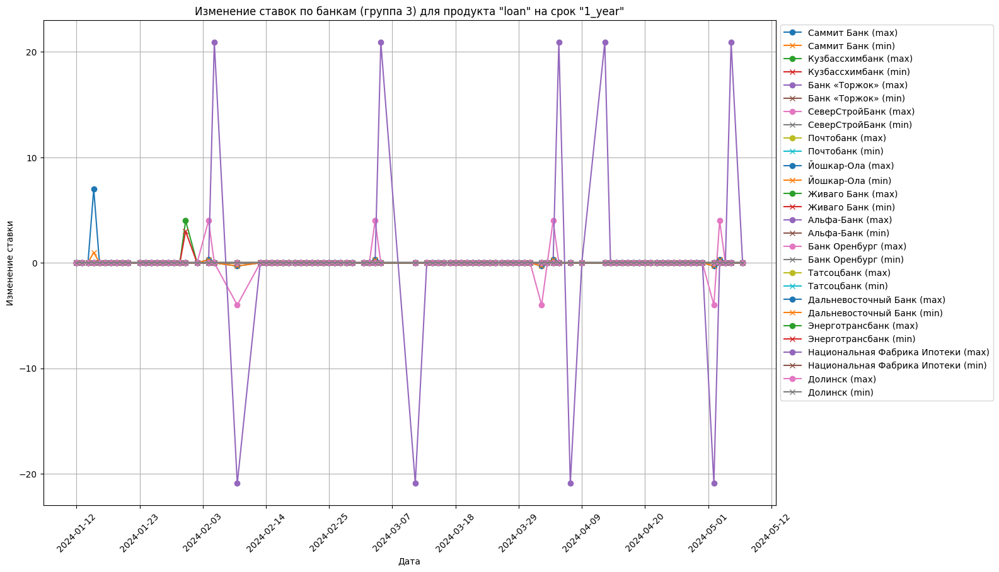

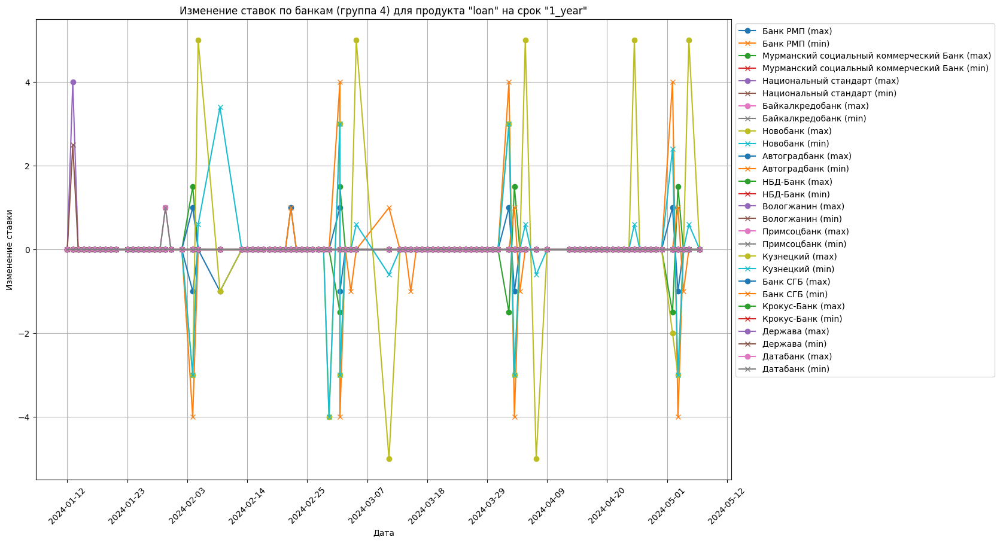

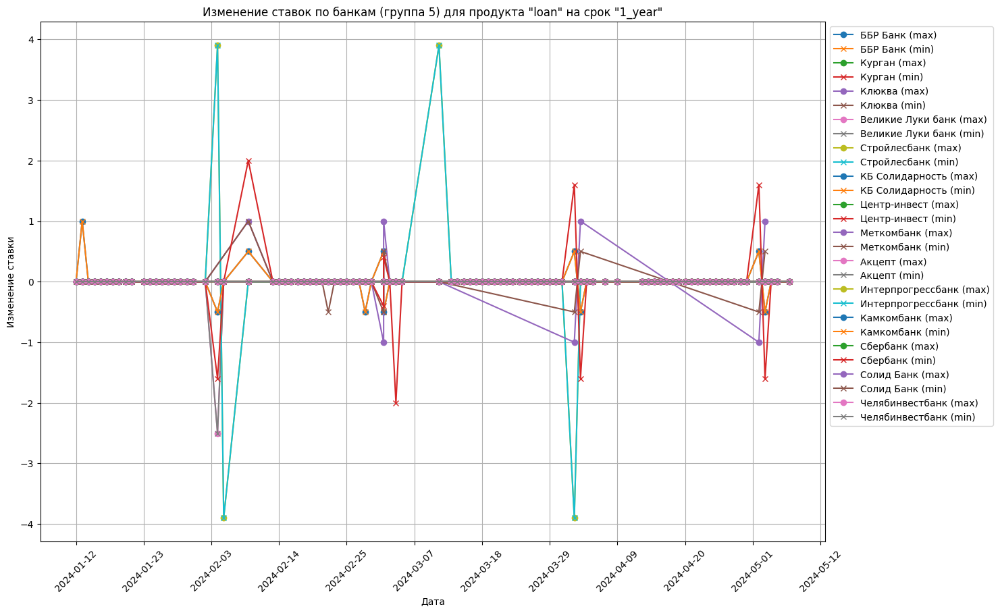

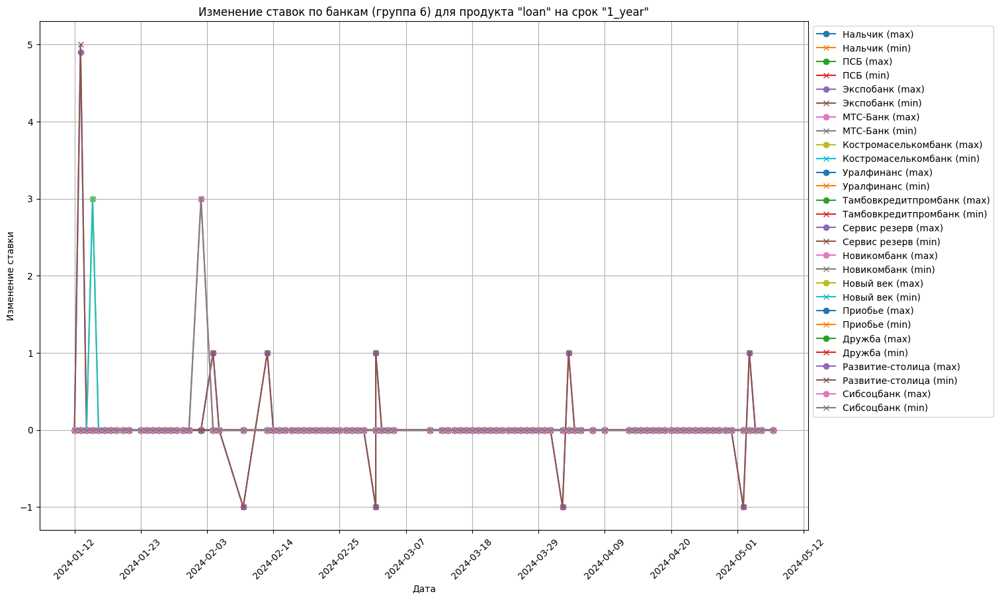

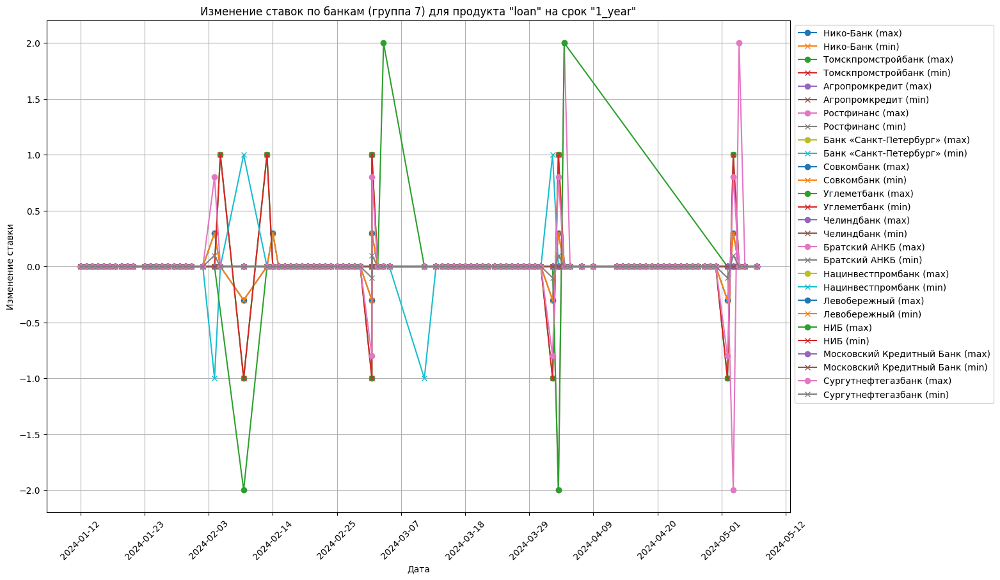

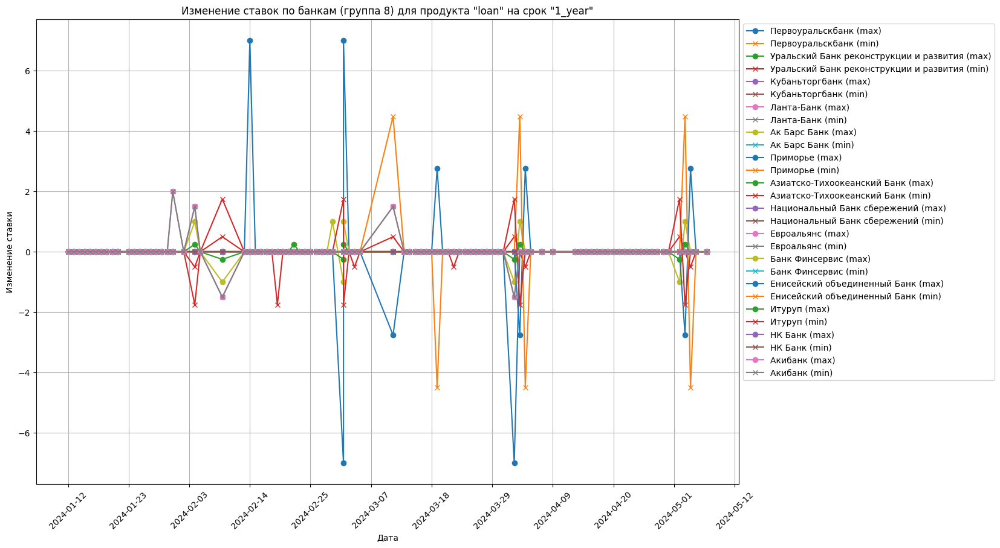

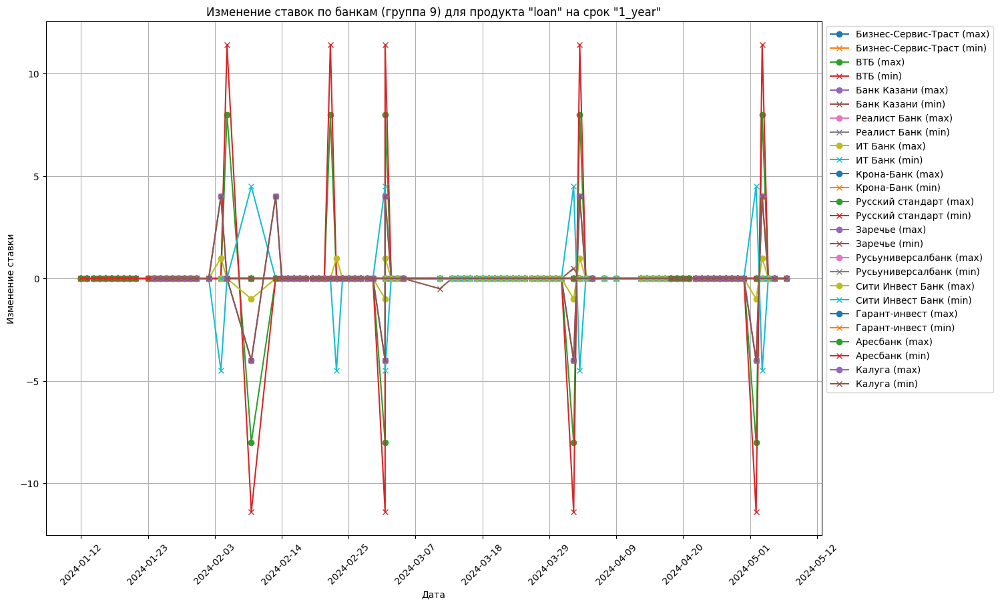

In [9]:
# Фильтрация данных по единому продукту: 'loan' на срок '1_year'
filtered_data_loan_1_year = all_data[(all_data['loan_type'] == 'loan') & (all_data['term'] == '1_year')]

# Группировка данных по банкам
grouped = filtered_data_loan_1_year.groupby(['Название банка','Минимальный возраст', 'Минимальная сумма', 'Максимальная сумма'])

# Инициализация столбцов для изменений
filtered_data_loan_1_year['max_rate_change'] = 0.0
filtered_data_loan_1_year['min_rate_change'] = 0.0

# Рассчитываем изменения ставок для каждой записи
for bank, group in grouped:
    group = group.sort_values(by='Дата')
    previous_max_rate = group['Максимальный процент'].iloc[0]
    previous_min_rate = group['Минимальный процент'].iloc[0]
    
    filtered_data_loan_1_year.loc[group.index[0], 'max_rate_change'] = 0
    filtered_data_loan_1_year.loc[group.index[0], 'min_rate_change'] = 0
    
    for idx in group.index[1:]:
        max_rate_change = filtered_data_loan_1_year.at[idx, 'Максимальный процент'] - previous_max_rate
        min_rate_change = filtered_data_loan_1_year.at[idx, 'Минимальный процент'] - previous_min_rate
        
        filtered_data_loan_1_year.at[idx, 'max_rate_change'] = max_rate_change
        filtered_data_loan_1_year.at[idx, 'min_rate_change'] = min_rate_change
        
        previous_max_rate = filtered_data_loan_1_year.at[idx, 'Максимальный процент']
        previous_min_rate = filtered_data_loan_1_year.at[idx, 'Минимальный процент']


# Фильтрация данных по диапазону дат
start_date = '2024-01-12'
end_date = '2024-05-12'
filtered_data_loan_1_year = filtered_data_loan_1_year[(filtered_data_loan_1_year['Дата'] >= start_date) & (filtered_data_loan_1_year['Дата'] <= end_date)]

# Установка значений max_rate_change и min_rate_change равными 0 для первой записи каждого банка
first_occurrences = filtered_data_loan_1_year.groupby(['Название банка', 'Минимальный возраст', 'Минимальная сумма', 'Максимальная сумма']).head(1)
filtered_data_loan_1_year.loc[first_occurrences.index, ['max_rate_change', 'min_rate_change']] = 0

# Сохранение итогового DataFrame в Excel
filtered_data_loan_1_year.to_excel('/Users/maximbortnik/Desktop/ALL/loan_1_year_filtered_data_withOUT_clusters.xlsx', index=False)

# Создаем полный диапазон дат
date_range = pd.date_range(start=start_date, end=end_date)
# Выбираем каждую 11-ю дату для отображения на оси X так как данные объемом 121 день
xticks = date_range[::11]

# Проверка наличия данных для каждого банка
if filtered_data_loan_1_year.empty:
    print("Данные для анализа отсутствуют после фильтрации и удаления NaN значений.")
else:
    # Получение списка уникальных банков
    unique_banks = filtered_data_loan_1_year['Название банка'].unique()
    
    # Разделение банков на 9 групп
    bank_groups = np.array_split(unique_banks, 9)
    
    # Построение графиков для каждой группы банков
    for i, bank_group in enumerate(bank_groups):
        plt.figure(figsize=(15, 10))
        
        for bank in bank_group:
            bank_data = filtered_data_loan_1_year[filtered_data_loan_1_year['Название банка'] == bank]
            plt.plot(bank_data['Дата'], bank_data['max_rate_change'], marker='o', label=f'{bank} (max)')
            plt.plot(bank_data['Дата'], bank_data['min_rate_change'], marker='x', label=f'{bank} (min)')
        
        plt.xlabel('Дата')
        plt.ylabel('Изменение ставки')
        plt.title(f'Изменение ставок по банкам (группа {i + 1}) для продукта "loan" на срок "1_year"')
        plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
        plt.xticks(xticks, rotation=45)
        plt.grid(True)
        plt.show()

/var/folders/bc/stp28mpd43n3qv1g5z13s7w00000gn/T/ipykernel_9943/4069378741.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_data_loan_3_years['max_rate_change'] = 0.0
/var/folders/bc/stp28mpd43n3qv1g5z13s7w00000gn/T/ipykernel_9943/4069378741.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_data_loan_3_years['min_rate_change'] = 0.0


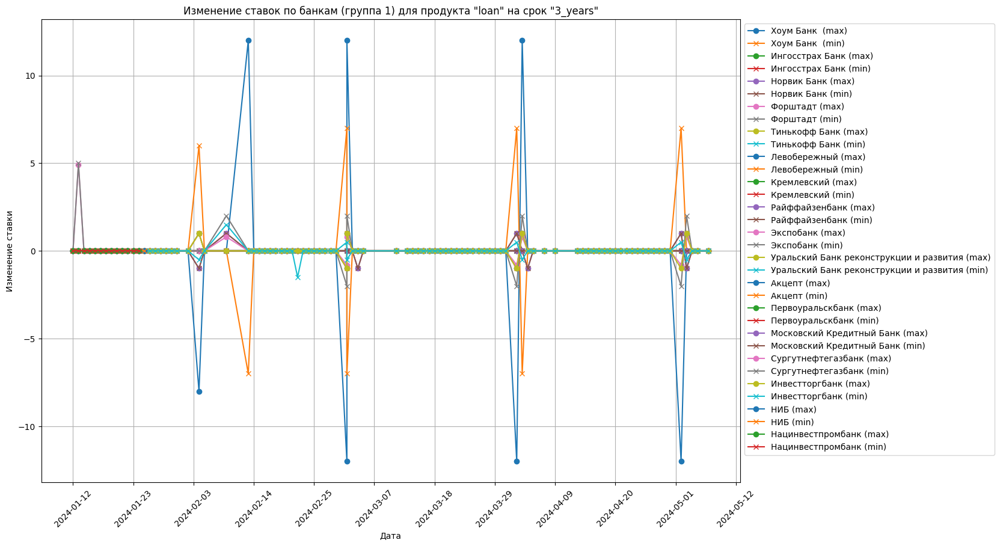

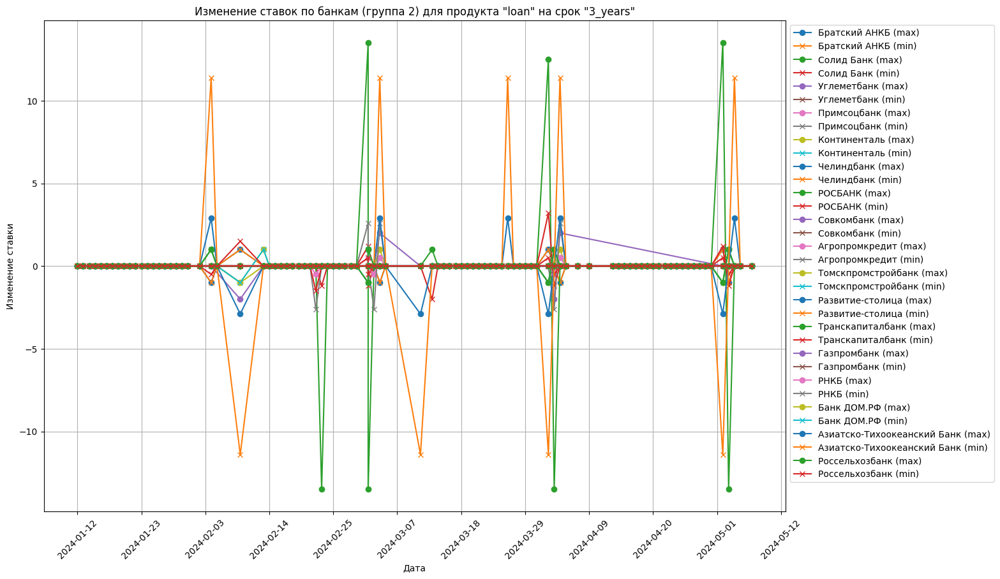

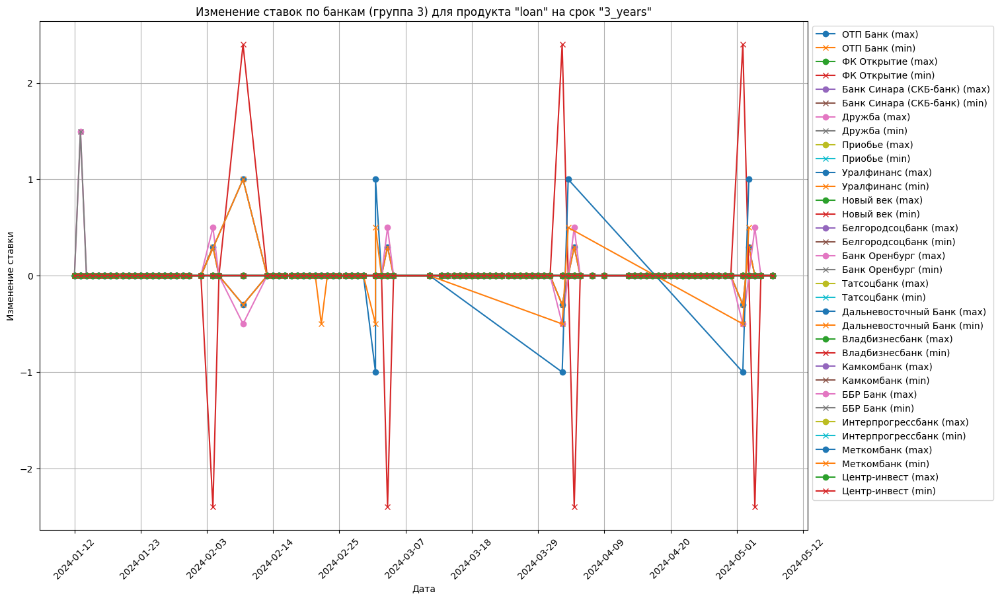

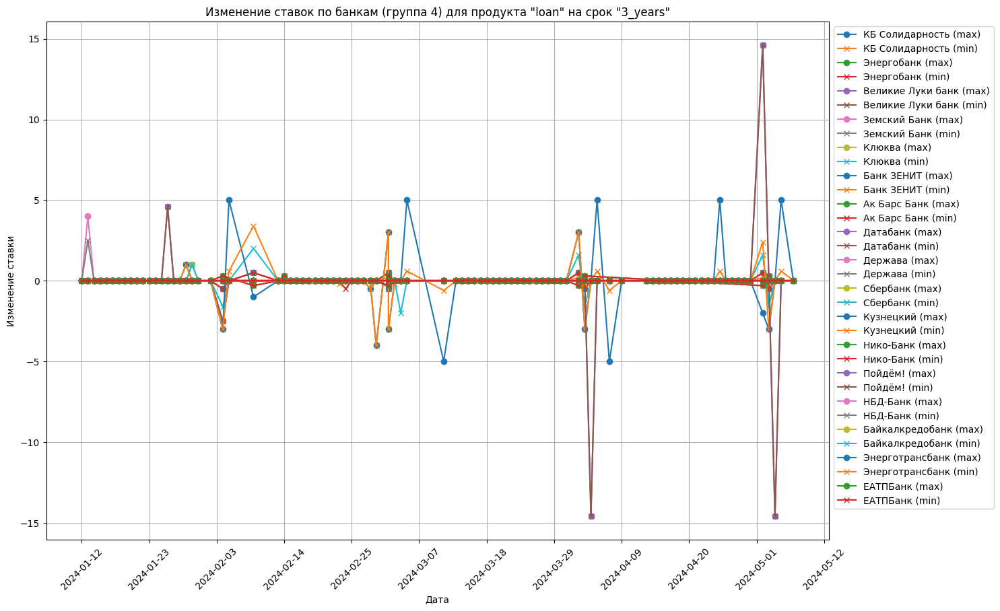

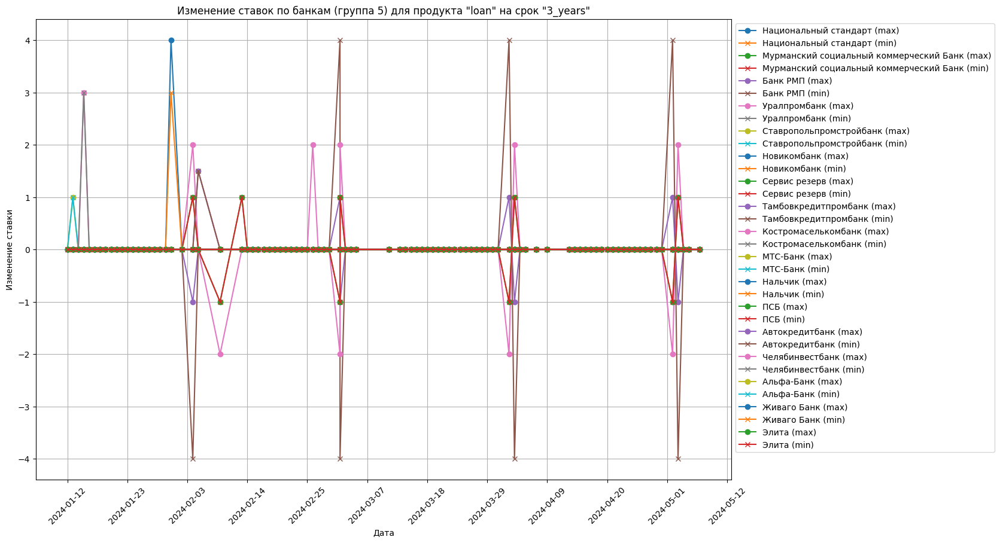

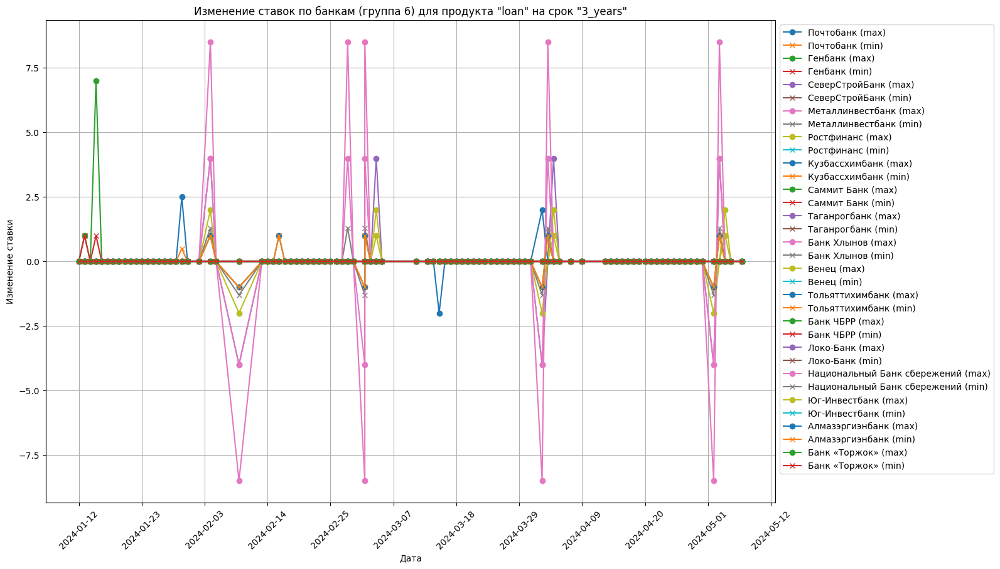

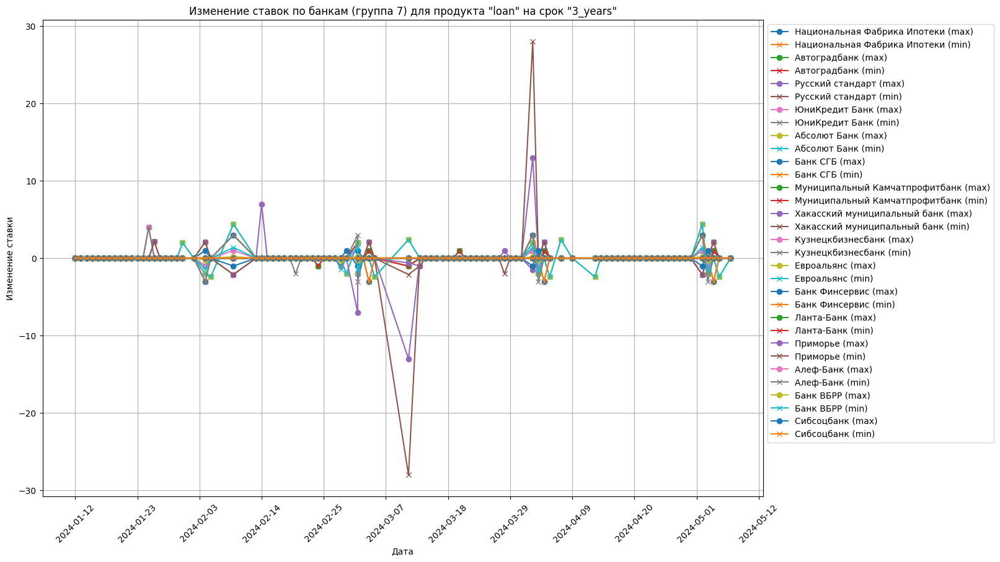

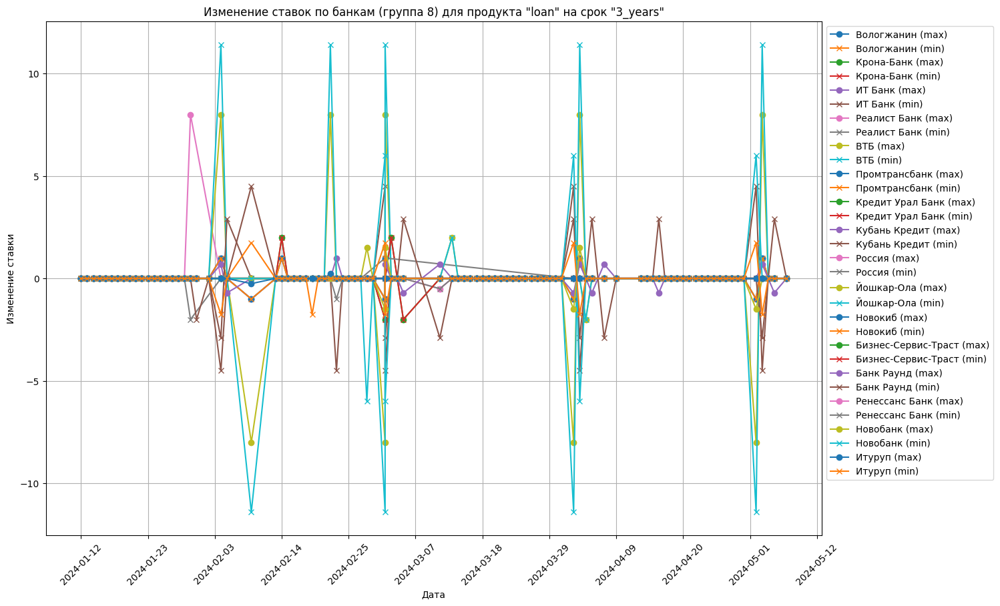

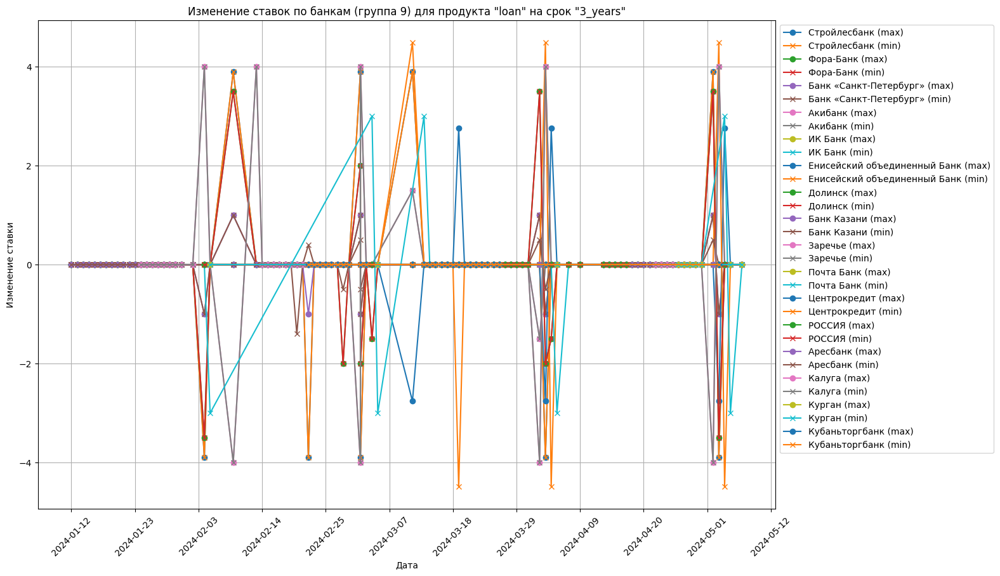

In [10]:
# Фильтрация данных по единому продукту: 'loan' на срок '3_years'
filtered_data_loan_3_years = all_data[(all_data['loan_type'] == 'loan') & (all_data['term'] == '3_years')]

# Группировка данных по банкам
grouped = filtered_data_loan_3_years.groupby(['Название банка','Минимальный возраст', 'Минимальная сумма', 'Максимальная сумма'])

# Инициализация столбцов для изменений
filtered_data_loan_3_years['max_rate_change'] = 0.0
filtered_data_loan_3_years['min_rate_change'] = 0.0

# Рассчитываем изменения ставок для каждой записи
for bank, group in grouped:
    group = group.sort_values(by='Дата')
    previous_max_rate = group['Максимальный процент'].iloc[0]
    previous_min_rate = group['Минимальный процент'].iloc[0]
    
    filtered_data_loan_3_years.loc[group.index[0], 'max_rate_change'] = 0
    filtered_data_loan_3_years.loc[group.index[0], 'min_rate_change'] = 0
    
    for idx in group.index[1:]:
        max_rate_change = filtered_data_loan_3_years.at[idx, 'Максимальный процент'] - previous_max_rate
        min_rate_change = filtered_data_loan_3_years.at[idx, 'Минимальный процент'] - previous_min_rate
        
        filtered_data_loan_3_years.at[idx, 'max_rate_change'] = max_rate_change
        filtered_data_loan_3_years.at[idx, 'min_rate_change'] = min_rate_change
        
        previous_max_rate = filtered_data_loan_3_years.at[idx, 'Максимальный процент']
        previous_min_rate = filtered_data_loan_3_years.at[idx, 'Минимальный процент']


# Фильтрация данных по диапазону дат
start_date = '2024-01-12'
end_date = '2024-05-12'
filtered_data_loan_3_years = filtered_data_loan_3_years[(filtered_data_loan_3_years['Дата'] >= start_date) & (filtered_data_loan_3_years['Дата'] <= end_date)]

# Установка значений max_rate_change и min_rate_change равными 0 для первой записи каждого банка
first_occurrences = filtered_data_loan_3_years.groupby(['Название банка', 'Минимальный возраст', 'Минимальная сумма', 'Максимальная сумма']).head(1)
filtered_data_loan_3_years.loc[first_occurrences.index, ['max_rate_change', 'min_rate_change']] = 0

# Сохранение итогового DataFrame в Excel
filtered_data_loan_3_years.to_excel('/Users/maximbortnik/Desktop/ALL/loan_3_years_filtered_data_withOUT_clusters.xlsx', index=False)

# Создаем полный диапазон дат
date_range = pd.date_range(start=start_date, end=end_date)
# Выбираем каждую 11-ю дату для отображения на оси X так как данные объемом 121 день
xticks = date_range[::11]

# Проверка наличия данных для каждого банка
if filtered_data_loan_3_years.empty:
    print("Данные для анализа отсутствуют после фильтрации и удаления NaN значений.")
else:
    # Получение списка уникальных банков
    unique_banks = filtered_data_loan_3_years['Название банка'].unique()
    
    # Разделение банков на 9 групп
    bank_groups = np.array_split(unique_banks, 9)
    
    # Построение графиков для каждой группы банков
    for i, bank_group in enumerate(bank_groups):
        plt.figure(figsize=(15, 10))
        
        for bank in bank_group:
            bank_data = filtered_data_loan_3_years[filtered_data_loan_3_years['Название банка'] == bank]
            plt.plot(bank_data['Дата'], bank_data['max_rate_change'], marker='o', label=f'{bank} (max)')
            plt.plot(bank_data['Дата'], bank_data['min_rate_change'], marker='x', label=f'{bank} (min)')
        
        plt.xlabel('Дата')
        plt.ylabel('Изменение ставки')
        plt.title(f'Изменение ставок по банкам (группа {i + 1}) для продукта "loan" на срок "3_years"')
        plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
        plt.xticks(xticks, rotation=45)
        plt.grid(True)
        plt.show()

/var/folders/bc/stp28mpd43n3qv1g5z13s7w00000gn/T/ipykernel_9943/34857203.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_data_loan_5_years['max_rate_change'] = 0.0
/var/folders/bc/stp28mpd43n3qv1g5z13s7w00000gn/T/ipykernel_9943/34857203.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_data_loan_5_years['min_rate_change'] = 0.0


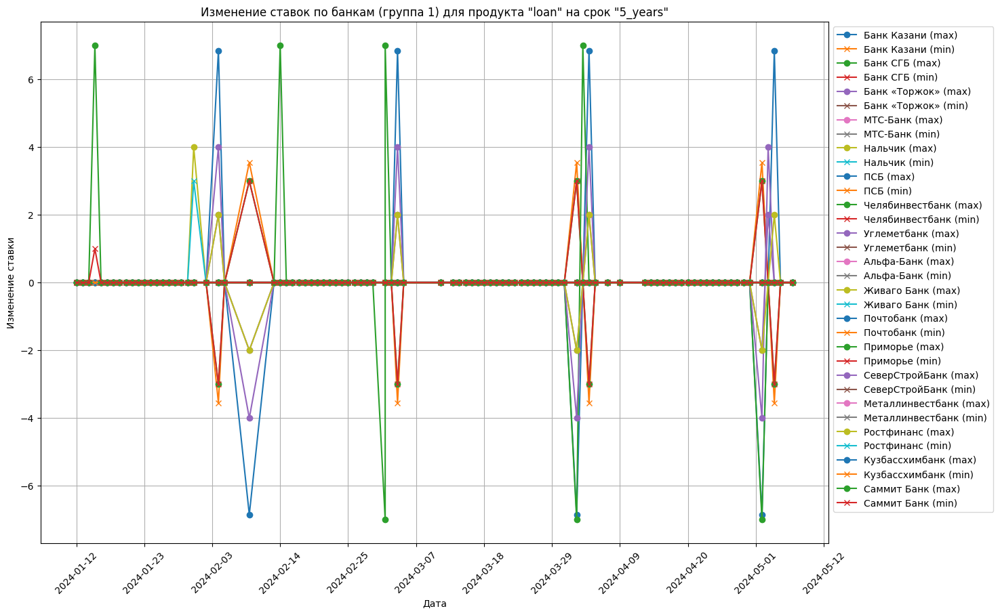

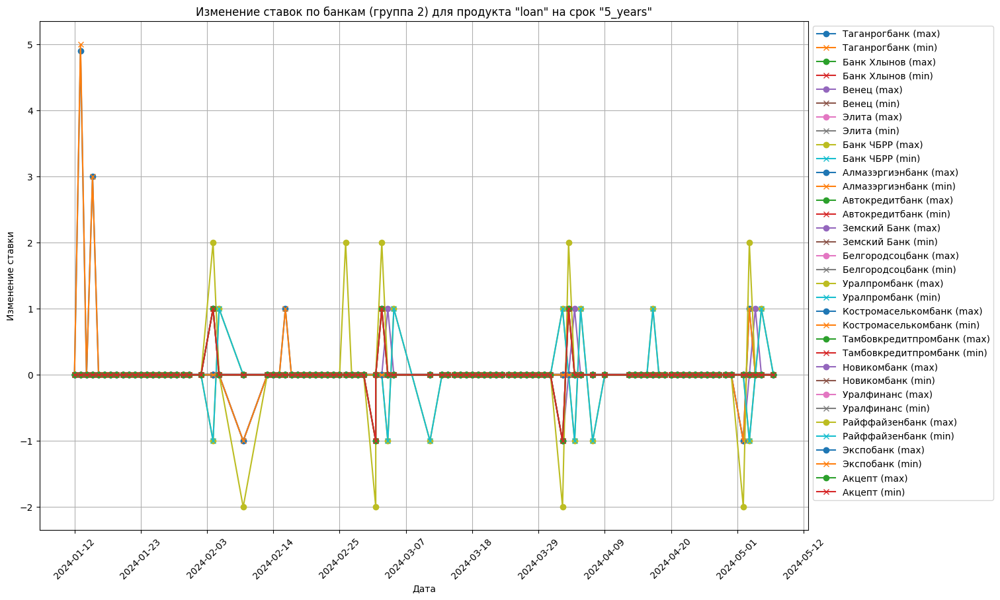

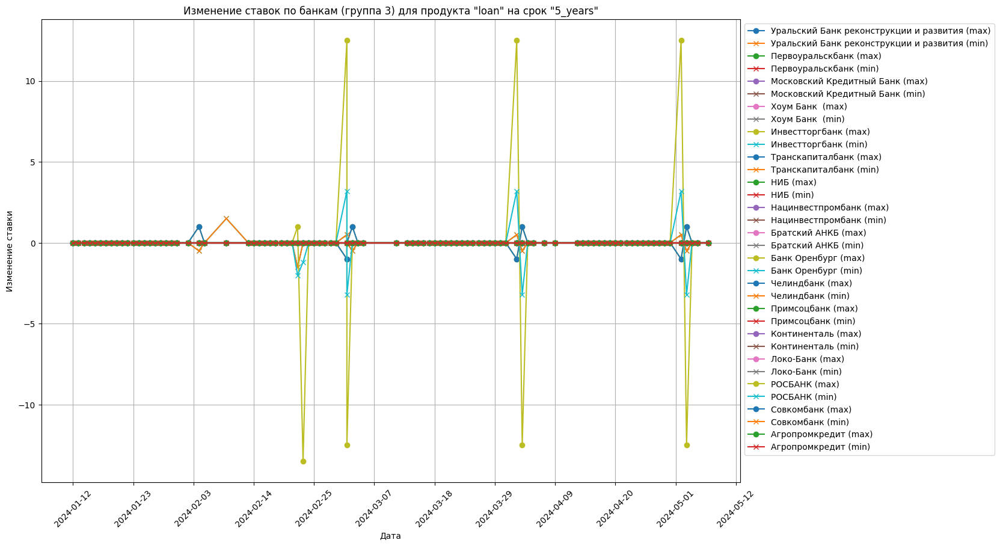

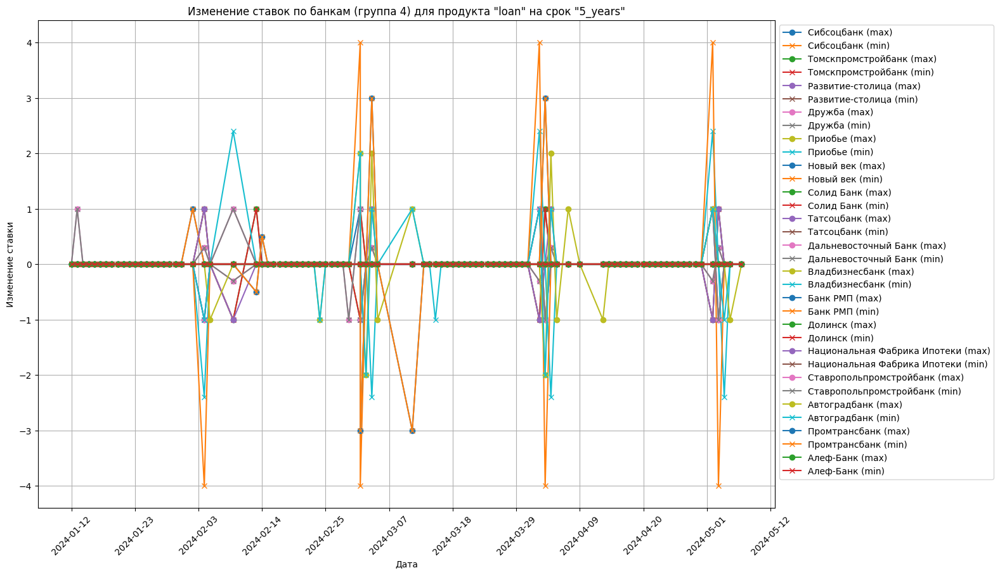

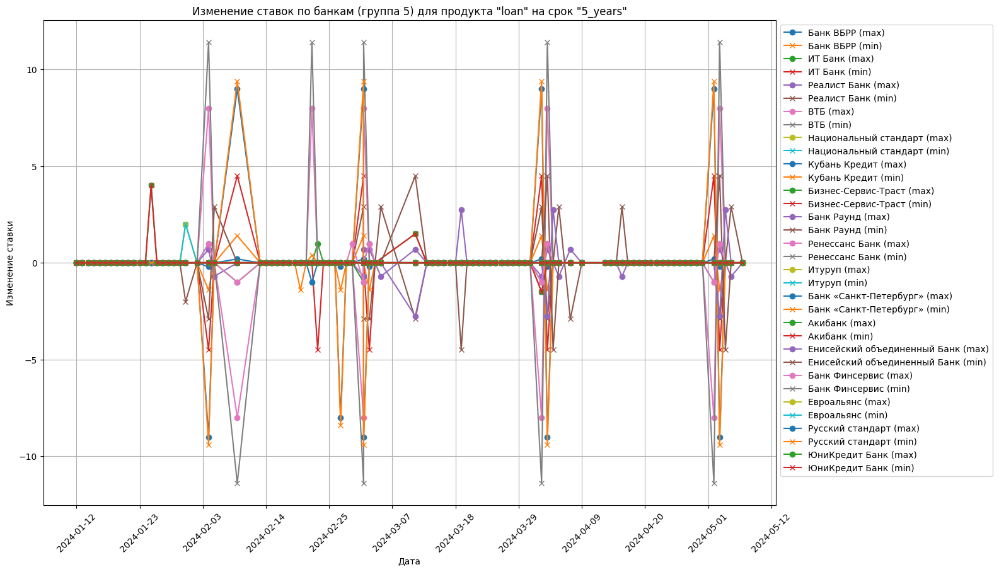

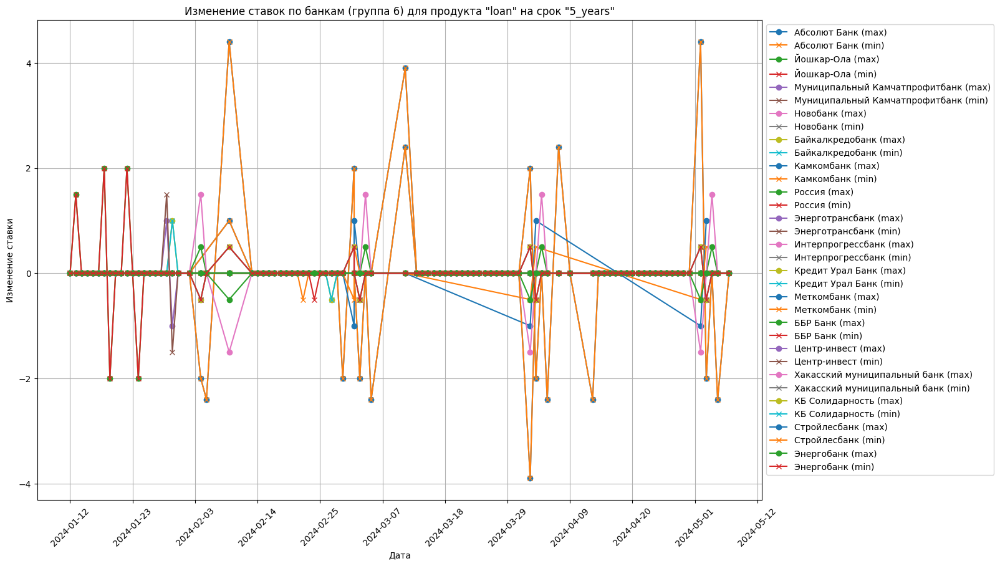

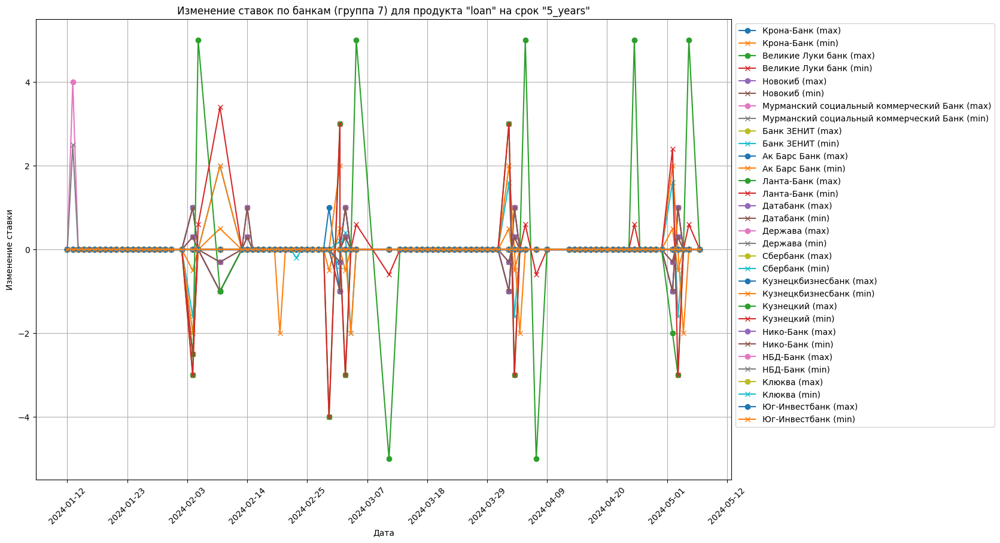

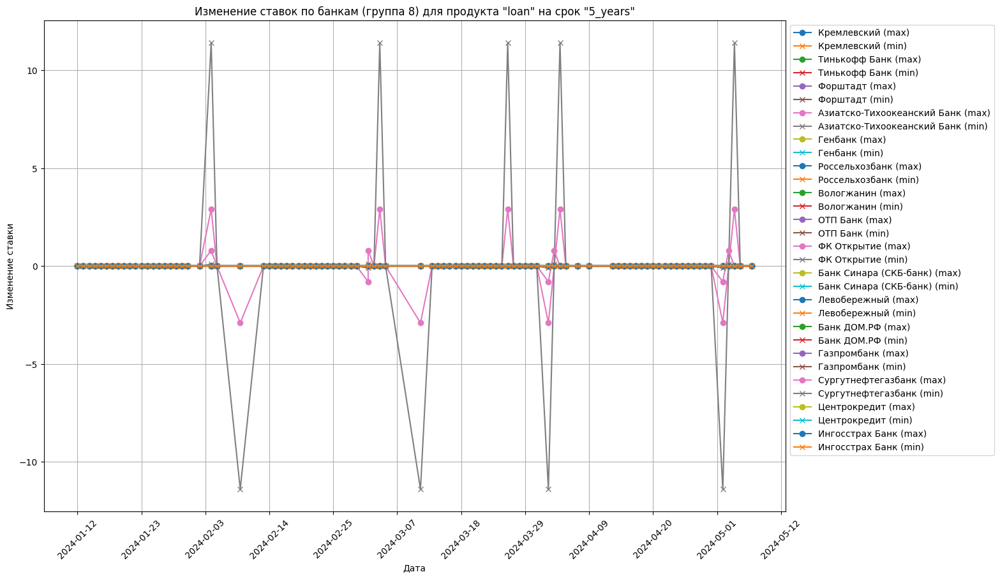

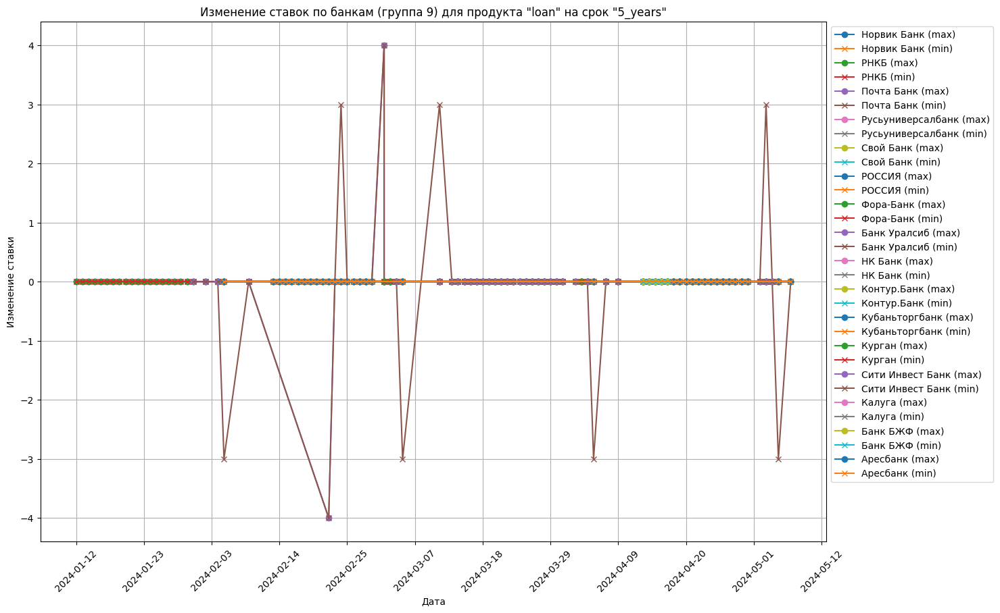

In [11]:
# Фильтрация данных по единому продукту: 'loan' на срок '5_years'
filtered_data_loan_5_years = all_data[(all_data['loan_type'] == 'loan') & (all_data['term'] == '5_years')]

# Группировка данных по банкам
grouped = filtered_data_loan_5_years.groupby(['Название банка','Минимальный возраст', 'Минимальная сумма', 'Максимальная сумма'])

# Инициализация столбцов для изменений
filtered_data_loan_5_years['max_rate_change'] = 0.0
filtered_data_loan_5_years['min_rate_change'] = 0.0

# Рассчитываем изменения ставок для каждой записи
for bank, group in grouped:
    group = group.sort_values(by='Дата')
    previous_max_rate = group['Максимальный процент'].iloc[0]
    previous_min_rate = group['Минимальный процент'].iloc[0]
    
    filtered_data_loan_5_years.loc[group.index[0], 'max_rate_change'] = 0
    filtered_data_loan_5_years.loc[group.index[0], 'min_rate_change'] = 0
    
    for idx in group.index[1:]:
        max_rate_change = filtered_data_loan_5_years.at[idx, 'Максимальный процент'] - previous_max_rate
        min_rate_change = filtered_data_loan_5_years.at[idx, 'Минимальный процент'] - previous_min_rate
        
        filtered_data_loan_5_years.at[idx, 'max_rate_change'] = max_rate_change
        filtered_data_loan_5_years.at[idx, 'min_rate_change'] = min_rate_change
        
        previous_max_rate = filtered_data_loan_5_years.at[idx, 'Максимальный процент']
        previous_min_rate = filtered_data_loan_5_years.at[idx, 'Минимальный процент']


# Фильтрация данных по диапазону дат
start_date = '2024-01-12'
end_date = '2024-05-12'
filtered_data_loan_5_years = filtered_data_loan_5_years[(filtered_data_loan_5_years['Дата'] >= start_date) & (filtered_data_loan_5_years['Дата'] <= end_date)]

# Установка значений max_rate_change и min_rate_change равными 0 для первой записи каждого банка
first_occurrences = filtered_data_loan_5_years.groupby(['Название банка', 'Минимальный возраст', 'Минимальная сумма', 'Максимальная сумма']).head(1)
filtered_data_loan_5_years.loc[first_occurrences.index, ['max_rate_change', 'min_rate_change']] = 0

# Сохранение итогового DataFrame в Excel
filtered_data_loan_5_years.to_excel('/Users/maximbortnik/Desktop/ALL/loan_5_years_filtered_data_withOUT_clusters.xlsx', index=False)

# Создаем полный диапазон дат
date_range = pd.date_range(start=start_date, end=end_date)
# Выбираем каждую 11-ю дату для отображения на оси X так как данные объемом 121 день
xticks = date_range[::11]

# Проверка наличия данных для каждого банка
if filtered_data_loan_5_years.empty:
    print("Данные для анализа отсутствуют после фильтрации и удаления NaN значений.")
else:
    # Получение списка уникальных банков
    unique_banks = filtered_data_loan_5_years['Название банка'].unique()
    
    # Разделение банков на 9 групп
    bank_groups = np.array_split(unique_banks, 9)
    
    # Построение графиков для каждой группы банков
    for i, bank_group in enumerate(bank_groups):
        plt.figure(figsize=(15, 10))
        
        for bank in bank_group:
            bank_data = filtered_data_loan_5_years[filtered_data_loan_5_years['Название банка'] == bank]
            plt.plot(bank_data['Дата'], bank_data['max_rate_change'], marker='o', label=f'{bank} (max)')
            plt.plot(bank_data['Дата'], bank_data['min_rate_change'], marker='x', label=f'{bank} (min)')
        
        plt.xlabel('Дата')
        plt.ylabel('Изменение ставки')
        plt.title(f'Изменение ставок по банкам (группа {i + 1}) для продукта "loan" на срок "5_years"')
        plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
        plt.xticks(xticks, rotation=45)
        plt.grid(True)
        plt.show()

/var/folders/bc/stp28mpd43n3qv1g5z13s7w00000gn/T/ipykernel_9943/2894620989.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_data_loan_10_years['max_rate_change'] = 0.0
/var/folders/bc/stp28mpd43n3qv1g5z13s7w00000gn/T/ipykernel_9943/2894620989.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_data_loan_10_years['min_rate_change'] = 0.0


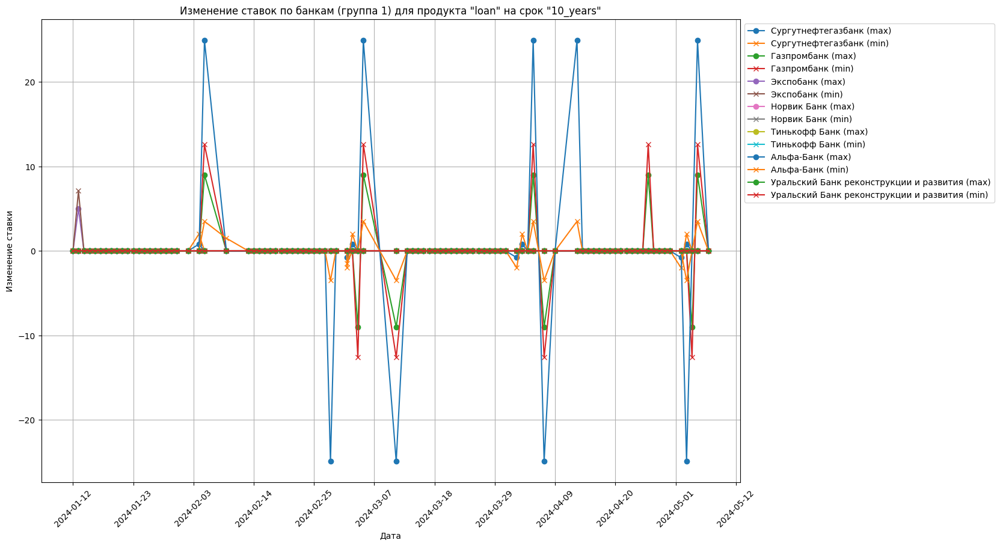

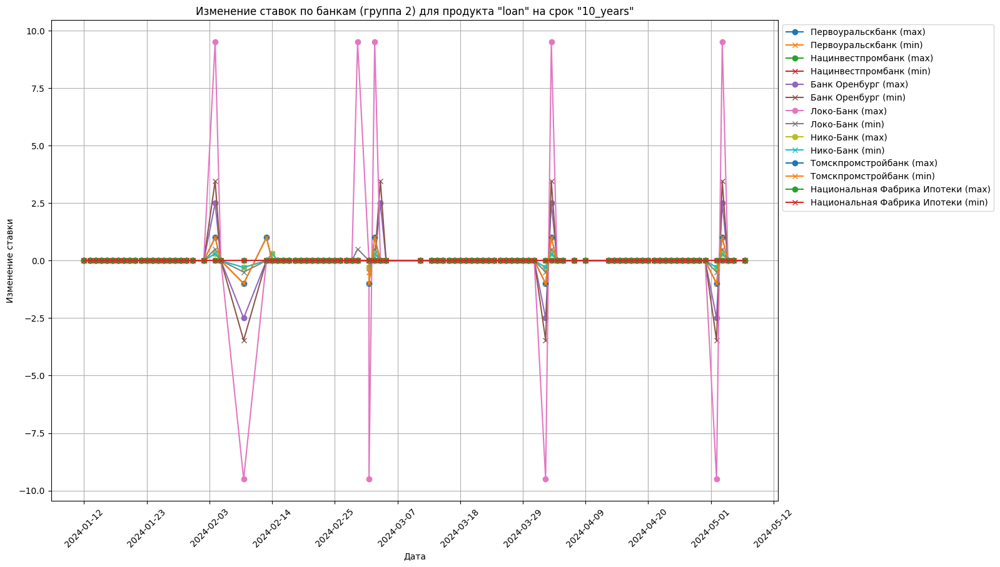

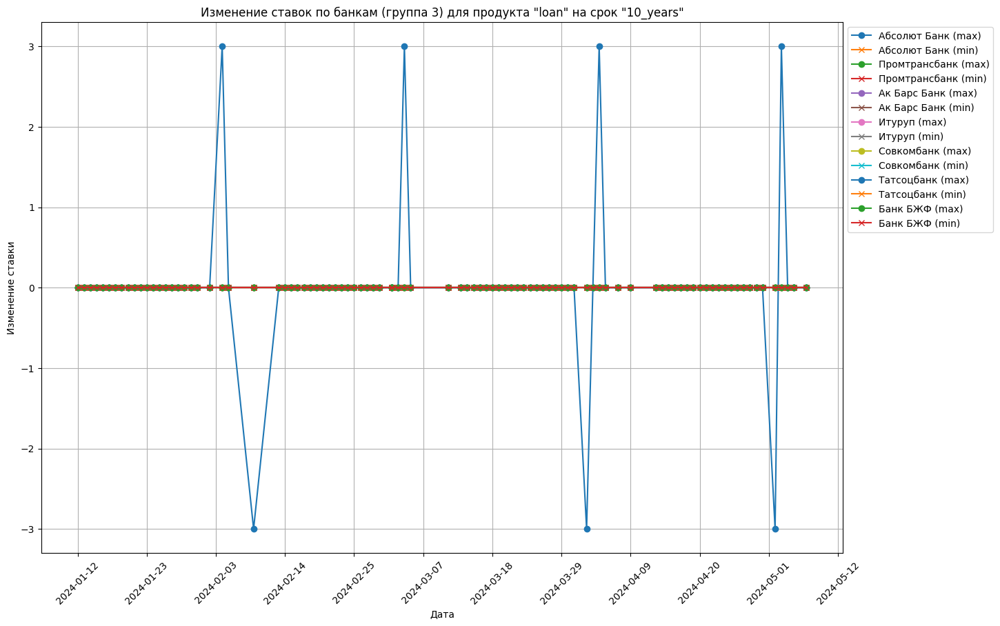

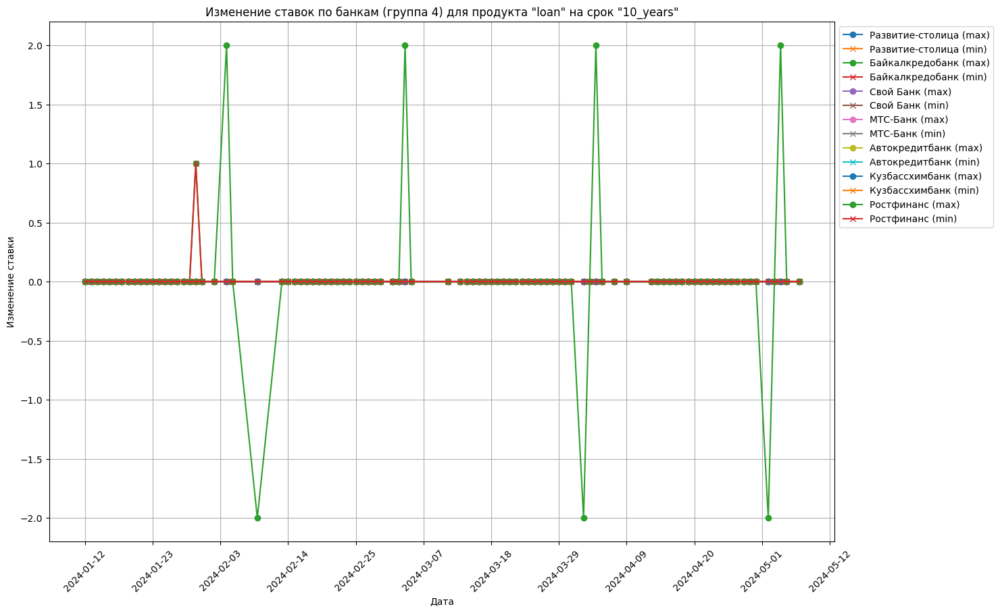

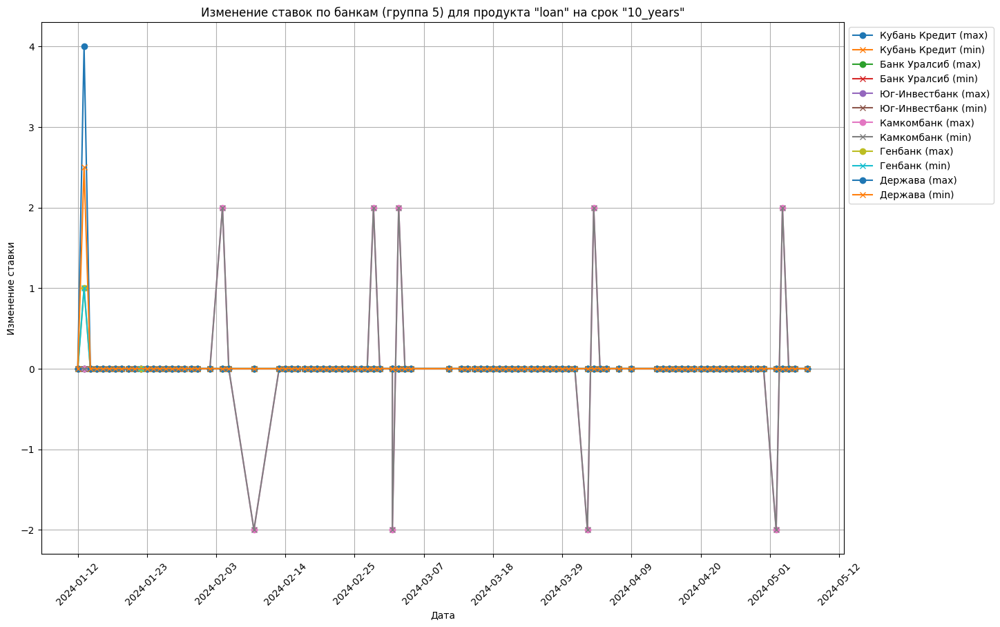

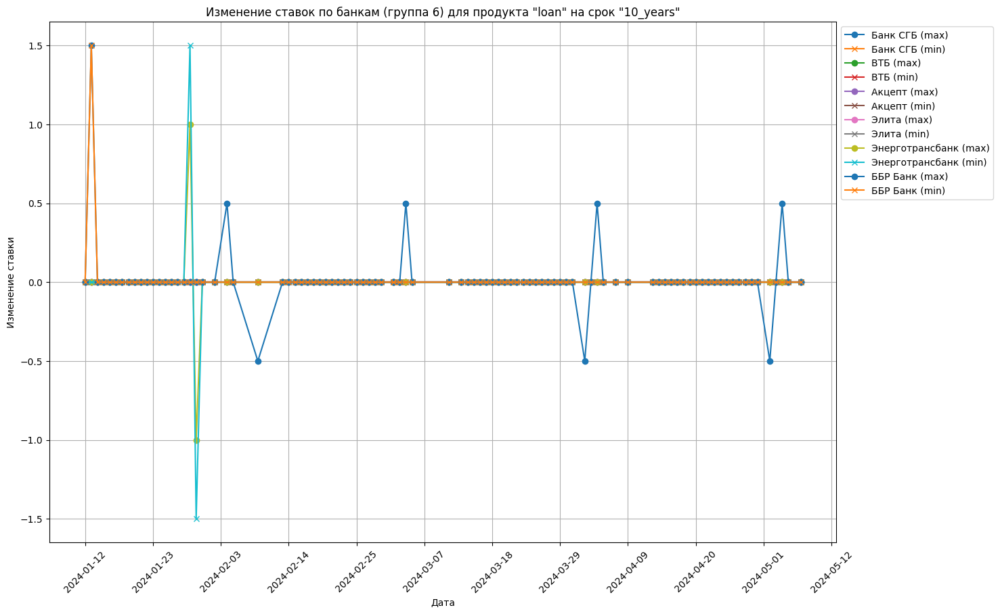

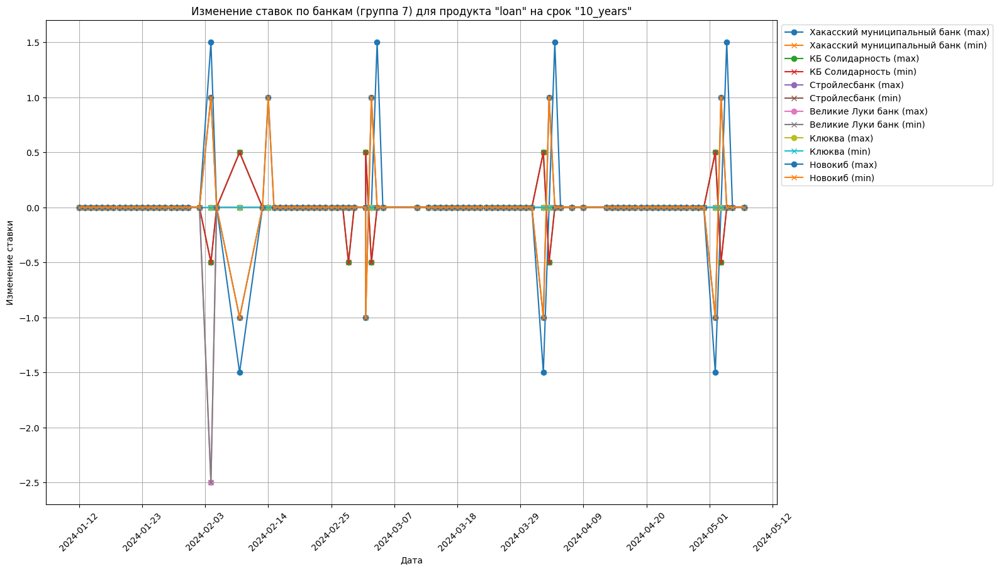

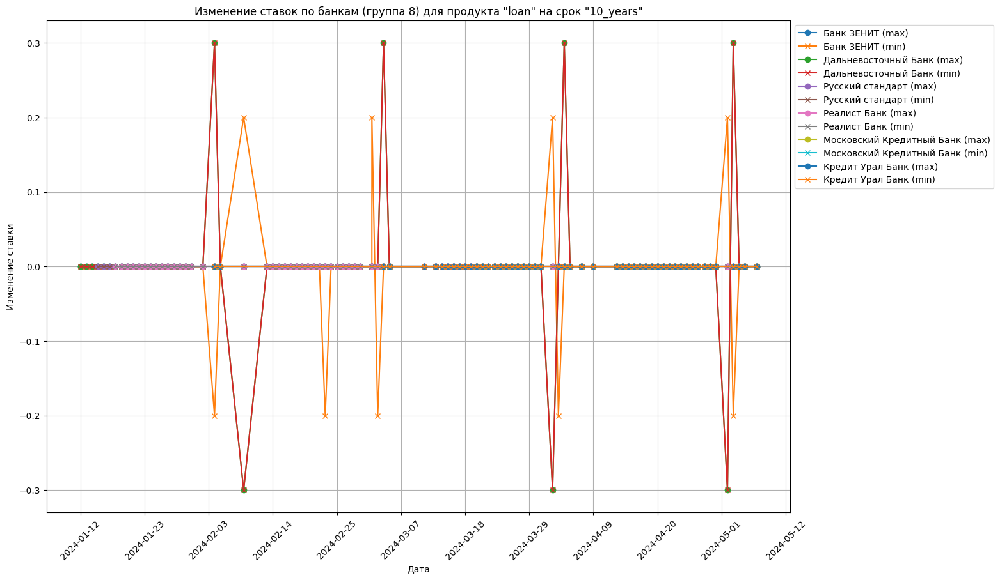

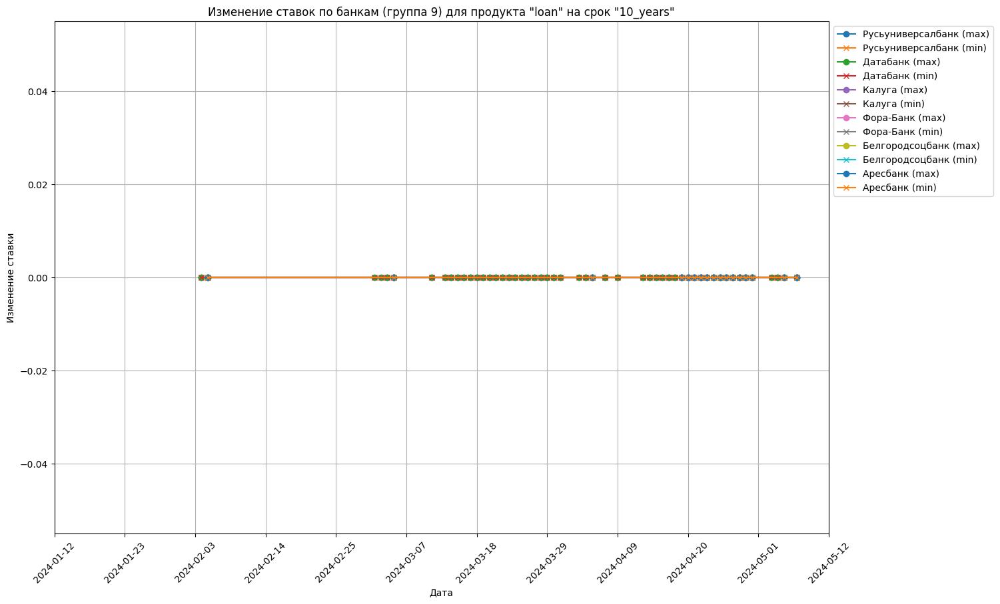

In [12]:
# Фильтрация данных по единому продукту: 'loan' на срок '10_years'
filtered_data_loan_10_years = all_data[(all_data['loan_type'] == 'loan') & (all_data['term'] == '10_years')]

# Группировка данных по банкам
grouped = filtered_data_loan_10_years.groupby(['Название банка','Минимальный возраст', 'Минимальная сумма', 'Максимальная сумма'])

# Инициализация столбцов для изменений
filtered_data_loan_10_years['max_rate_change'] = 0.0
filtered_data_loan_10_years['min_rate_change'] = 0.0

# Рассчитываем изменения ставок для каждой записи
for bank, group in grouped:
    group = group.sort_values(by='Дата')
    previous_max_rate = group['Максимальный процент'].iloc[0]
    previous_min_rate = group['Минимальный процент'].iloc[0]
    
    filtered_data_loan_10_years.loc[group.index[0], 'max_rate_change'] = 0
    filtered_data_loan_10_years.loc[group.index[0], 'min_rate_change'] = 0
    
    for idx in group.index[1:]:
        max_rate_change = filtered_data_loan_10_years.at[idx, 'Максимальный процент'] - previous_max_rate
        min_rate_change = filtered_data_loan_10_years.at[idx, 'Минимальный процент'] - previous_min_rate
        
        filtered_data_loan_10_years.at[idx, 'max_rate_change'] = max_rate_change
        filtered_data_loan_10_years.at[idx, 'min_rate_change'] = min_rate_change
        
        previous_max_rate = filtered_data_loan_10_years.at[idx, 'Максимальный процент']
        previous_min_rate = filtered_data_loan_10_years.at[idx, 'Минимальный процент']


# Фильтрация данных по диапазону дат
start_date = '2024-01-12'
end_date = '2024-05-12'
filtered_data_loan_10_years = filtered_data_loan_10_years[(filtered_data_loan_10_years['Дата'] >= start_date) & (filtered_data_loan_10_years['Дата'] <= end_date)]

# Установка значений max_rate_change и min_rate_change равными 0 для первой записи каждого банка
first_occurrences = filtered_data_loan_10_years.groupby(['Название банка', 'Минимальный возраст', 'Минимальная сумма', 'Максимальная сумма']).head(1)
filtered_data_loan_10_years.loc[first_occurrences.index, ['max_rate_change', 'min_rate_change']] = 0

# Сохранение итогового DataFrame в Excel
filtered_data_loan_10_years.to_excel('/Users/maximbortnik/Desktop/ALL/loan_10_years_filtered_data_withOUT_clusters.xlsx', index=False)

# Создаем полный диапазон дат
date_range = pd.date_range(start=start_date, end=end_date)
# Выбираем каждую 11-ю дату для отображения на оси X так как данные объемом 121 день
xticks = date_range[::11]

# Проверка наличия данных для каждого банка
if filtered_data_loan_10_years.empty:
    print("Данные для анализа отсутствуют после фильтрации и удаления NaN значений.")
else:
    # Получение списка уникальных банков
    unique_banks = filtered_data_loan_10_years['Название банка'].unique()
    
    # Разделение банков на 9 групп
    bank_groups = np.array_split(unique_banks, 9)
    
    # Построение графиков для каждой группы банков
    for i, bank_group in enumerate(bank_groups):
        plt.figure(figsize=(15, 10))
        
        for bank in bank_group:
            bank_data = filtered_data_loan_10_years[filtered_data_loan_10_years['Название банка'] == bank]
            plt.plot(bank_data['Дата'], bank_data['max_rate_change'], marker='o', label=f'{bank} (max)')
            plt.plot(bank_data['Дата'], bank_data['min_rate_change'], marker='x', label=f'{bank} (min)')
        
        plt.xlabel('Дата')
        plt.ylabel('Изменение ставки')
        plt.title(f'Изменение ставок по банкам (группа {i + 1}) для продукта "loan" на срок "10_years"')
        plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
        plt.xticks(xticks, rotation=45)
        plt.grid(True)
        plt.show()